In [1]:
%matplotlib inline
from preamble import *
plt.rcParams['image.cmap'] = "gray"

## 3. Unsupervised Learning and Preprocessing

### 3.1 Types of unsupervised learning

- 비지도 변환 (Unsupervised Transform)
  - 차원 축소 (Dimensionality Reduction)
- 군집 (Clustering)

### 3.2 Challenges in unsupervised learning

- 비지도 학습은 데이터 과학자가 데이터를 더 잘 이해하고 싶을 때 탐색적 분석 (EDA) 단계에 많이 활용
- 지도 학습의 전처리 단뎨에서도 많이 활용

### 3.3 Preprocessing and Scaling
#### 3.3.1 Different Kinds of Preprocessing
- 스케일링 (Scaling): 
  - 각 데이터 특성들에 대해 다음과 같은 선형 변환을 통해 전체 특성들의 통계적 분포(스케일)를 동일하게 맞추는 과정. 
  - 각 특성(Column단위)들의 통계치를 이용한 변환 수행
  - 종류
    - StandardScaler
$$\dfrac{x_i – mean(x)}{stdev(x)}$$
      - 각 특성의 평균을 0, 분산을 1로 변경
      - 각 특성의 최소값 및 최대값을 제한하지 않음
      - 단점: Outlier (이상치)에 영향을 많이 받음<br/><br/>
    - RobustScaler
$$\dfrac{x_i – Q_2(x)}{Q_3(x) – Q_1(x)}$$
      - 중앙값(median, $Q_2(x)$)과 IQR(Inter-Quartile Range, $Q_3(x) – Q_1(x)$)을 이용해서 척도를 표준화하는 방법
      - median 값이 0이 되도록 함
      - 전체 특성 값과 매우 동떨어진 특성 값에 영향을 받지 않음<br/><br/>
    - MinMaxScaler
$$\dfrac{x_i – min(x)}{max(x) – min(x)}$$
      - 모든 특성이 정확하게 0과 1사이에 위치하도록 데이터를 변경
      - 2차원 데이터인 경우 모든 데이터가 x축의 0과 1사이, y축의 0과 1사이 사각 영역에 위치하게 됨

  - 참고
    - http://benalexkeen.com/feature-scaling-with-scikit-learn/
    - http://rfriend.tistory.com/269
    
- 정규화 (Nomalizer)
  - 각 특성 벡터의 유클리디안 길이가 1이 되도록 데이터 포인트를 조정
  - 즉, 2차원 데이터인 경우 지름이 1인 원에 데이터 포인트를 투영하고 3차원 데이터인 경우 지름이 1인 구에 데이터 포인트를 투영
  - 각 데이터(Row단위)들의 통계치를 이용한 변환 수행
  - 각 데이터가 서로 다른 비율로 스케일이 조정됨
  - 특성 벡터의 길이는 무관하고 데이터의 방향(각도)만이 중요할때 많이 사용
  - 종류
    - l1
    - l2 (기본)
    - max

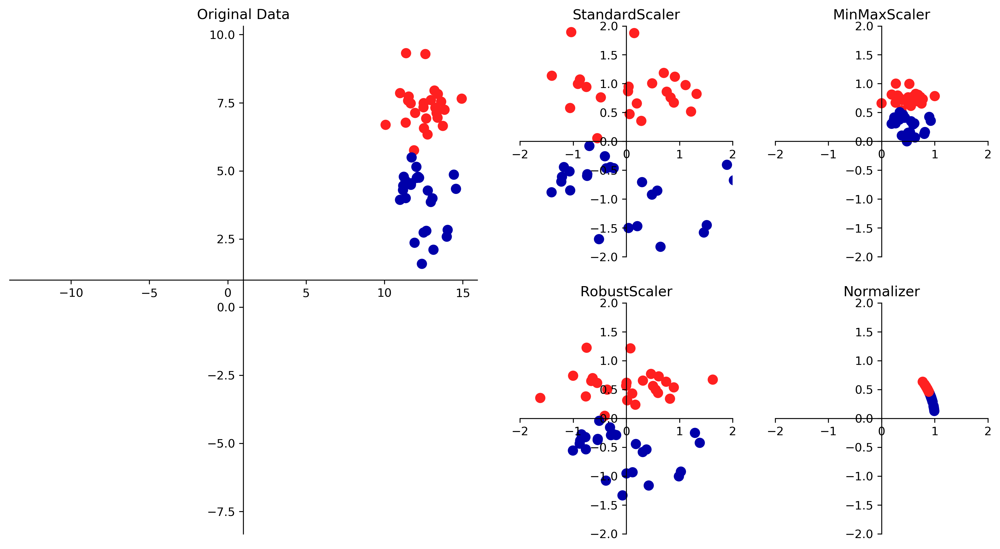

In [2]:
mglearn.plots.plot_scaling()

#### 3.3.2 Applying Data Transformations

In [3]:
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split
cancer = load_breast_cancer()

X_train, X_test, y_train, y_test = train_test_split(cancer.data, cancer.target, random_state=1)
print(X_train.shape)
print(y_train.shape)
print()
print(X_test.shape)
print(y_test.shape)

(426, 30)
(426,)

(143, 30)
(143,)


In [4]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

- 스케일링을 수행할 scaler에게 fit 함수를 호출함. 이때 훈련 데이터만 넘겨줌

In [5]:
scaler.fit(X_train)

MinMaxScaler(copy=True, feature_range=(0, 1))

- 실제로 훈련 데이터의 스케일을 조정하려면 scaler의 transform 메소드를 호출함.

In [6]:
# transform data
X_train_scaled = scaler.transform(X_train)

# print dataset properties before and after scaling
print("transformed shape: {}".format(X_train_scaled.shape))

# axis=0 --> 426개의 데이터들에 대해 동일한 Colume에 속한 각 특성값들에 대해 MinMaxScaling을 수행함
print("per-feature minimum before scaling:\n {}".format(X_train.min(axis=0))) 
print("per-feature maximum before scaling:\n {}".format(X_train.max(axis=0)))
print("per-feature minimum after scaling:\n {}".format(X_train_scaled.min(axis=0)))
print("per-feature maximum after scaling:\n {}".format(X_train_scaled.max(axis=0)))

transformed shape: (426, 30)
per-feature minimum before scaling:
 [   6.981    9.71    43.79   143.5      0.053    0.019    0.       0.
    0.106    0.05     0.115    0.36     0.757    6.802    0.002    0.002
    0.       0.       0.01     0.001    7.93    12.02    50.41   185.2
    0.071    0.027    0.       0.       0.157    0.055]
per-feature maximum before scaling:
 [   28.11     39.28    188.5    2501.        0.163     0.287     0.427
     0.201     0.304     0.096     2.873     4.885    21.98    542.2
     0.031     0.135     0.396     0.053     0.061     0.03     36.04
    49.54    251.2    4254.        0.223     0.938     1.17      0.291
     0.577     0.149]
per-feature minimum after scaling:
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
per-feature maximum after scaling:
 [ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.]


- 테스트 데이터도 변환해줌
  - [주의] 테스트 데이터 변환시에 항상 훈련 데이터들의 통계치만을 사용
  - 즉, 테스트 데이터에 대해 다음과 같은 공식을 통하여 변환
$$\dfrac{x_{test_{ij}} – x_{train_{min_j}}}{x_{train_{max_j}} – x_{train_{min_j}}}$$
  - 위 식에서 i는 각 데이터 인덱스, j는 각 데이터들에 대한 특성 인덱스. 즉, min_j와 max_j는 동일한 j번째 특성들 전체에 대한 최소 및 최대값을 의미 

In [7]:
# transform test data
X_test_scaled = scaler.transform(X_test)

# print test data properties after scaling
print("per-feature minimum after scaling:\n{}".format(X_test_scaled.min(axis=0)))
print("per-feature maximum after scaling:\n{}".format(X_test_scaled.max(axis=0)))

per-feature minimum after scaling:
[ 0.034  0.023  0.031  0.011  0.141  0.044  0.     0.     0.154 -0.006
 -0.001  0.006  0.004  0.001  0.039  0.011  0.     0.    -0.032  0.007
  0.027  0.058  0.02   0.009  0.109  0.026  0.     0.    -0.    -0.002]
per-feature maximum after scaling:
[ 0.958  0.815  0.956  0.894  0.811  1.22   0.88   0.933  0.932  1.037
  0.427  0.498  0.441  0.284  0.487  0.739  0.767  0.629  1.337  0.391
  0.896  0.793  0.849  0.745  0.915  1.132  1.07   0.924  1.205  1.631]


#### 3.3.3 Scaling training and test data the same way

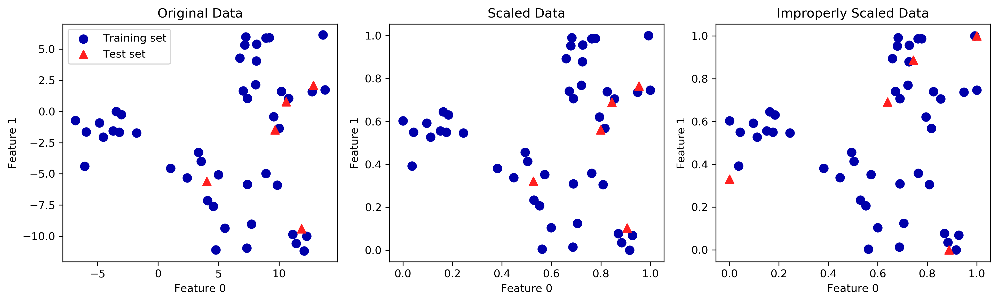

In [8]:
from sklearn.datasets import make_blobs
# make synthetic data
X, _ = make_blobs(n_samples=50, centers=5, random_state=4, cluster_std=2)
# split it into training and test sets
X_train, X_test = train_test_split(X, random_state=5, test_size=.1)

# plot the training and test sets
fig, axes = plt.subplots(1, 3, figsize=(13, 4))
axes[0].scatter(X_train[:, 0], X_train[:, 1], c=mglearn.cm2(0), label="Training set", s=60)
axes[0].scatter(X_test[:, 0], X_test[:, 1], marker='^', c=mglearn.cm2(1), label="Test set", s=60)
axes[0].legend(loc='upper left')
axes[0].set_title("Original Data")

# scale the data using MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

# visualize the properly scaled data
axes[1].scatter(X_train_scaled[:, 0], X_train_scaled[:, 1], c=mglearn.cm2(0), label="Training set", s=60)
axes[1].scatter(X_test_scaled[:, 0], X_test_scaled[:, 1], marker='^', c=mglearn.cm2(1), label="Test set", s=60)
axes[1].set_title("Scaled Data")

# rescale the test set separately
# so test set min is 0 and test set max is 1
# DO NOT DO THIS! For illustration purposes only.
test_scaler = MinMaxScaler()
test_scaler.fit(X_test)
X_test_scaled_badly = test_scaler.transform(X_test)

# visualize wrongly scaled data
axes[2].scatter(X_train_scaled[:, 0], X_train_scaled[:, 1], c=mglearn.cm2(0), label="training set", s=60)
axes[2].scatter(X_test_scaled_badly[:, 0], X_test_scaled_badly[:, 1], marker='^', c=mglearn.cm2(1), label="test set", s=60)
axes[2].set_title("Improperly Scaled Data")

for ax in axes:
    ax.set_xlabel("Feature 0")
    ax.set_ylabel("Feature 1")
fig.tight_layout()

- 위에서 첫번째 그래프와 두번째 그래프는 축의 눈금이 변한 것을 제외하면 동일함

[단축 메소드 사용]
- fit --> transform
- fit_transform

In [9]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
# calling fit and transform in sequence (using method chaining)
X_scaled = scaler.fit(X_train).transform(X_train)
# same result, but more efficient computation
X_scaled_d = scaler.fit_transform(X_train)

#### 3.3.4 The effect of preprocessing on supervised learning

- C: 규제의 강도를 결정하는 매개변수
  - 높은 C 값: 규제의 감소 --> 훈련 세트에 최대로 맞춤
  - 낮은 C 값: 규제의 증대 --> 계수 백터(w)를 최대로 0에 가깝게 만듦

In [10]:
from sklearn.svm import SVC

X_train, X_test, y_train, y_test = train_test_split(cancer.data, cancer.target, random_state=0)

svm = SVC(C=100)
svm.fit(X_train, y_train)
print("Test set accuracy: {:.2f}".format(svm.score(X_test, y_test)))

Test set accuracy: 0.63


- MinMaxScaler 사용

In [11]:
# preprocessing using 0-1 scaling
scaler = MinMaxScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

# learning an SVM on the scaled training data
svm.fit(X_train_scaled, y_train)

# scoring on the scaled test set
print("Scaled test set accuracy: {:.2f}".format(svm.score(X_test_scaled, y_test)))

Scaled test set accuracy: 0.97


- StandardScaler 사용

In [12]:
# preprocessing using zero mean and unit variance scaling
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

# learning an SVM on the scaled training data
svm.fit(X_train_scaled, y_train)

# scoring on the scaled test set
print("SVM test accuracy: {:.2f}".format(svm.score(X_test_scaled, y_test)))

SVM test accuracy: 0.96


### 3.4 Dimensionality Reduction, Feature Extraction and Manifold Learning
- Principal Component Analysis (PCA)
  - 가장 간단하고 흔히 사용하는 대표적인 기법
- Non-negative matrix factorization (NMF)
  - 특성 추출에 널리 사용
- t-distributed stochastic neighbor embedding (t-SNE)
  - 2차원 산점도를 이용해 시각화 용도로 많이 활용

#### 3.4.1 Principal Component Analysis (PCA)

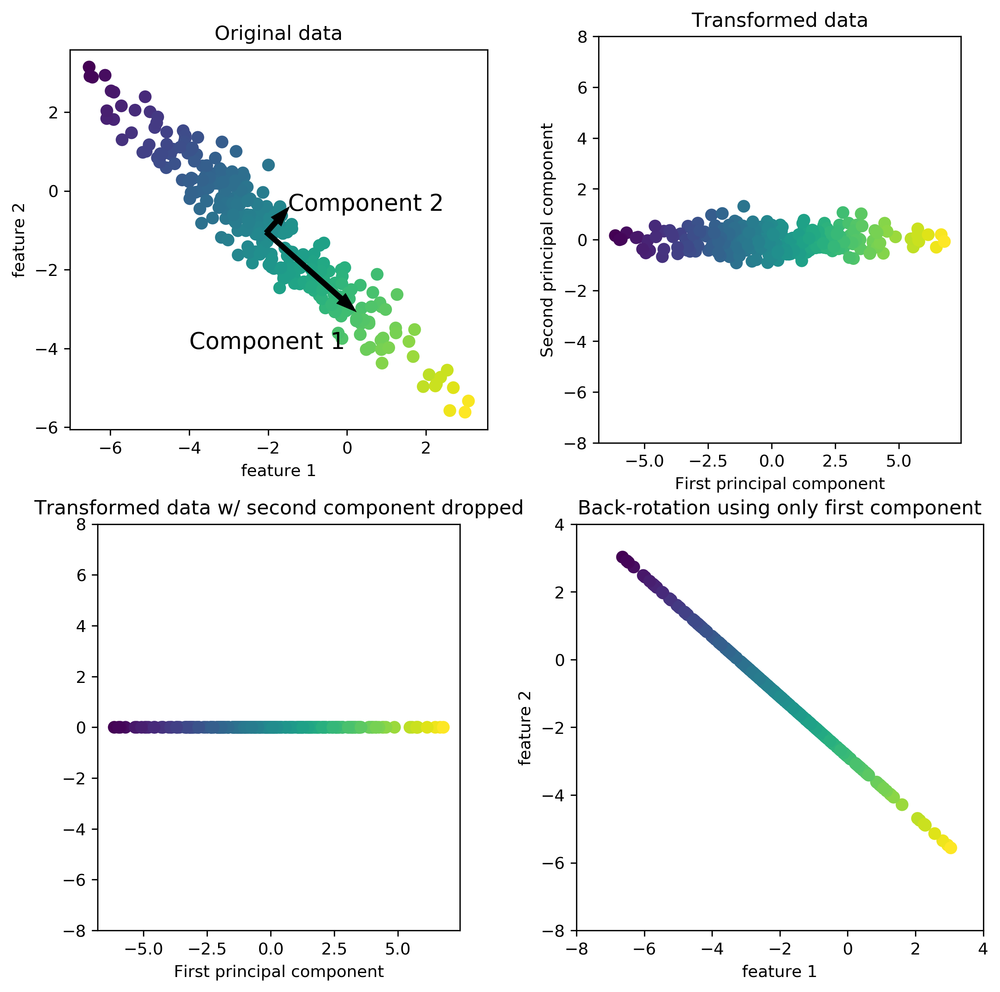

In [13]:
mglearn.plots.plot_pca_illustration()

- 그래프 1
  - 성분 1: 원본 데이터에서 분산이 가장 큰 벡터 (원본 데이터에서 가장 많은 정보를 담고 있음)
  - 성분 2: 성분 1 벡터와 직각인 방향 중 분간이 가장 큰 벡터
    - 2차원에서는 성분 1 벡터와 직각인 벡터가 1개만 존재
    - 고차원에서는 여러개의 직각 벡터 존재 가능
  - 위와 같은 방법을 거쳐 찾은 두 개의 성분 1, 2를 주성분(Principal Component)라고 함
- 그래프 2
  - 주성분 1과 주성분 2를 각각 x축과 y축에 나란하도록 회전한 그림
  - 회전하기 전에 각 특성값에서 평균을 빼서 중심을 원점에 맞추었음
- 그래프 3
  - 주성분 1만 남기는 차원 축소 (Dimensionality Reduction) 수행 결과
  - 2차원 원본 데이터가 1차원 데이터로 변환됨
- 그래프 4
  - 주성분 1 벡터를 원래의 특성 공간으로 다시 옮김
  - 최종적으로 원본 데이터에서 노이즈를 제거하고 좀 더 나은 데이터 시각화 제공

In [14]:
a = np.array([[1, 2, 3], [4, 5, 6]])
print(a)

[[1 2 3]
 [4 5 6]]


In [15]:
v = np.cov(a)
print(v)

[[ 1.  1.]
 [ 1.  1.]]


In [16]:
from numpy import linalg as la
e = la.eig(v)
print(e[0])
print(e[1])

[ 2.  0.]
[[ 0.707 -0.707]
 [ 0.707  0.707]]


##### Applying PCA to the cancer dataset for visualization
- 유방함 데이터의 특성값의 개수는 30개
- 30개의 특성들에 대한 산점도 그래프를 그리면 총 435개의 산점도가 산출됨
  - $_{30}C_2 = \displaystyle \frac{30!}{2!28!} = \displaystyle \frac{30 \times 29}{2}=15 \times 29 = 435$
- 이렇게 데이터 특성 개수가 많을 때 (데이터 차원이 높을때) 보다 더 쉽게 특성 데이터들을 시각화 하는 방법
  - 악성(Malignant)와 양성(Benign)에 대해 30개 특성의 히스토그램을 그리는 것 

cancer.data.shape: (569, 30)


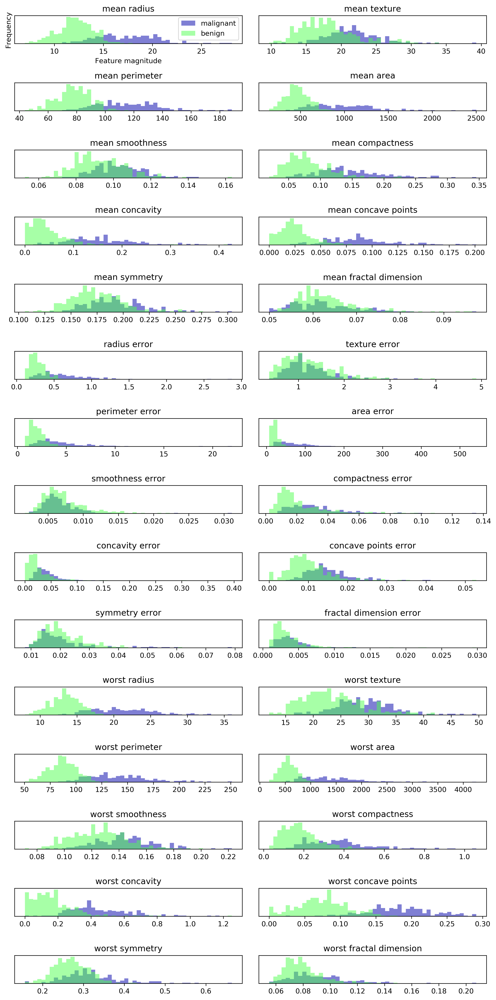

In [17]:
print("cancer.data.shape: {}".format(cancer.data.shape))

fig, axes = plt.subplots(15, 2, figsize=(10, 20))
malignant = cancer.data[cancer.target == 0]
benign = cancer.data[cancer.target == 1]

ax = axes.ravel()

for i in range(30):
    _, bins = np.histogram(cancer.data[:, i], bins=50)
    ax[i].hist(malignant[:, i], bins=bins, color=mglearn.cm3(0), alpha=.5)
    ax[i].hist(benign[:, i], bins=bins, color=mglearn.cm3(2), alpha=.5)
    ax[i].set_title(cancer.feature_names[i])
    ax[i].set_yticks(())
ax[0].set_xlabel("Feature magnitude")
ax[0].set_ylabel("Frequency")
ax[0].legend(["malignant", "benign"], loc="best")
fig.tight_layout()

- 위 그래프에서 다음 두 개의 특성 주목
  - smoothness error: 두 히스토그램이 겹쳐서 별로 쓸모 없는 특성임
  - worst concave points: 두 히스토그램이 확실이 구분되어 매우 유용한 특성임

- PCA 적용전에 StandardScaler를 사용하여 각 특성마다 특성값들의 분산이 1이 되도록 스케일링

In [18]:
from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()
scaler = StandardScaler()

scaler.fit(cancer.data)
X_scaled = scaler.transform(cancer.data)
print("X_scaled.shape: {}".format(X_scaled.shape))

X_scaled.shape: (569, 30)


- PCA 
  - n_components: 차원 축소의 결과로 남게될 차원의 개수
    - 기본 값: 원본 데이터의 차원과 동일. 즉, 데이터를 회전만 시키고 모든 주성분을 원본 데이터 그대로 유지

In [19]:
from sklearn.decomposition import PCA
# keep the first two principal components of the data
pca = PCA(n_components=2)
# fit PCA model to beast cancer data
pca.fit(X_scaled)

# transform data onto the first two principal components
X_pca = pca.transform(X_scaled)
print("Original shape: {}".format(str(X_scaled.shape)))
print("Reduced shape: {}".format(str(X_pca.shape)))

Original shape: (569, 30)
Reduced shape: (569, 2)


Text(0,0.5,'Second principal component')

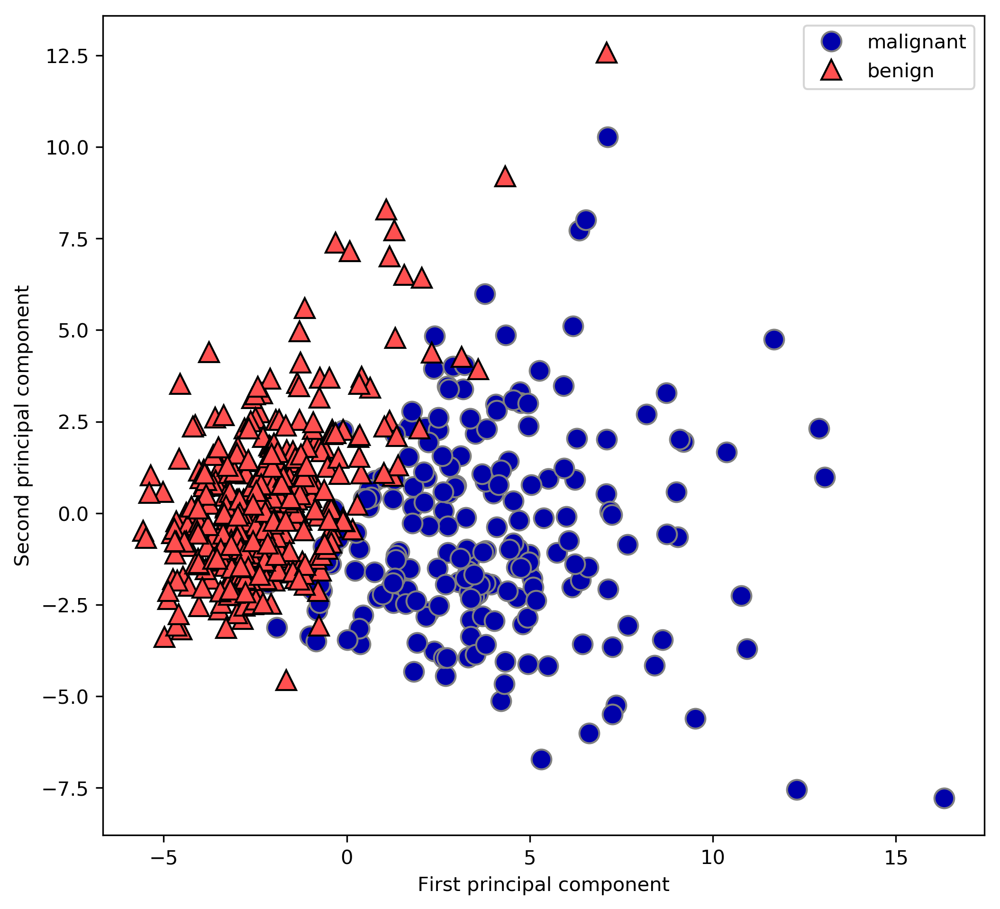

In [20]:
# plot first vs. second principal component, colored by class
plt.figure(figsize=(8, 8))
mglearn.discrete_scatter(X_pca[:, 0], X_pca[:, 1], cancer.target)
plt.legend(cancer.target_names, loc="best")
plt.gca().set_aspect("equal")
plt.xlabel("First principal component")
plt.ylabel("Second principal component")

- 첫번째 주성분과 두번째 주성분을 사용하여 구성한 산점도
  - 두 개의 클래스가 2차원 공간에서 꽤 잘 구분되는 것을 확인
  - 악성 데이터가 양성 데이터보다 더 넓은 구역에 분포함을 알 수 있음
- 산출된 주성분은 원본 데이터에 있는 해당 주성분 방향에 대응하는 여러 특성이 조합된 형태
  - components_  변수
    - 주성분이 담겨 있음

In [21]:
print("PCA component shape: {}".format(pca.components_.shape))

PCA component shape: (2, 30)


In [22]:
print("PCA components:\n{}".format(pca.components_))

PCA components:
[[ 0.219  0.104  0.228  0.221  0.143  0.239  0.258  0.261  0.138  0.064
   0.206  0.017  0.211  0.203  0.015  0.17   0.154  0.183  0.042  0.103
   0.228  0.104  0.237  0.225  0.128  0.21   0.229  0.251  0.123  0.132]
 [-0.234 -0.06  -0.215 -0.231  0.186  0.152  0.06  -0.035  0.19   0.367
  -0.106  0.09  -0.089 -0.152  0.204  0.233  0.197  0.13   0.184  0.28
  -0.22  -0.045 -0.2   -0.219  0.172  0.144  0.098 -0.008  0.142  0.275]]


Text(0,0.5,'Principal components')

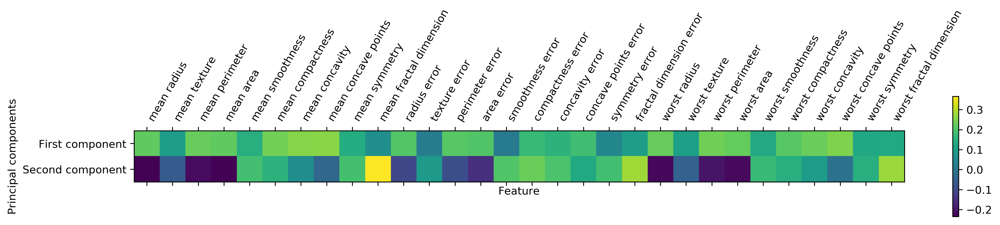

In [23]:
plt.matshow(pca.components_, cmap='viridis')
plt.yticks([0, 1], ["First component", "Second component"])
plt.colorbar()
plt.xticks(range(len(cancer.feature_names)),
           cancer.feature_names, rotation=60, ha='left')
plt.xlabel("Feature")
plt.ylabel("Principal components")

- PCA이후의 분류 정확도 변화

In [24]:
from sklearn.datasets import load_breast_cancer
from sklearn.ensemble import GradientBoostingClassifier

cancer = load_breast_cancer()
scaler = StandardScaler()

scaler.fit(cancer.data)
X_scaled = scaler.transform(cancer.data)
print("X_scaled.shape: {}".format(X_scaled.shape))

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, 
    cancer.target, 
    stratify=cancer.target, 
    random_state=66
)

gbrt = GradientBoostingClassifier(random_state=0)
gbrt.fit(X_train, y_train)

print("Accuracy on training set: {:.3f}".format(gbrt.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(gbrt.score(X_test, y_test)))

X_scaled.shape: (569, 30)
Accuracy on training set: 1.000
Accuracy on test set: 0.958


In [25]:
from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()
scaler = StandardScaler()

scaler.fit(cancer.data)
X_scaled = scaler.transform(cancer.data)

pca = PCA(n_components=2)
# fit PCA model to beast cancer data
pca.fit(X_scaled)

# transform data onto the first two principal components
X_pca = pca.transform(X_scaled)
print("X_pca.shape: {}".format(X_pca.shape))

X_train, X_test, y_train, y_test = train_test_split(
    X_pca, 
    cancer.target, 
    stratify=cancer.target, 
    random_state=66
)

gbrt = GradientBoostingClassifier(random_state=0)
gbrt.fit(X_train, y_train)

print("Accuracy on training set: {:.3f}".format(gbrt.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(gbrt.score(X_test, y_test)))

X_pca.shape: (569, 2)
Accuracy on training set: 1.000
Accuracy on test set: 0.944


- explained_variance_ratio
  - Percentage of variance explained by each of the selected components.
  - 주성분들을 활용하여 원본 데이터에 대하여 설명할 수 있는 분산의 정도
  - 자동으로 주성분 개수가 결정

7
[ 0.443  0.19   0.094  0.066  0.055  0.04   0.023]
0.910095300697


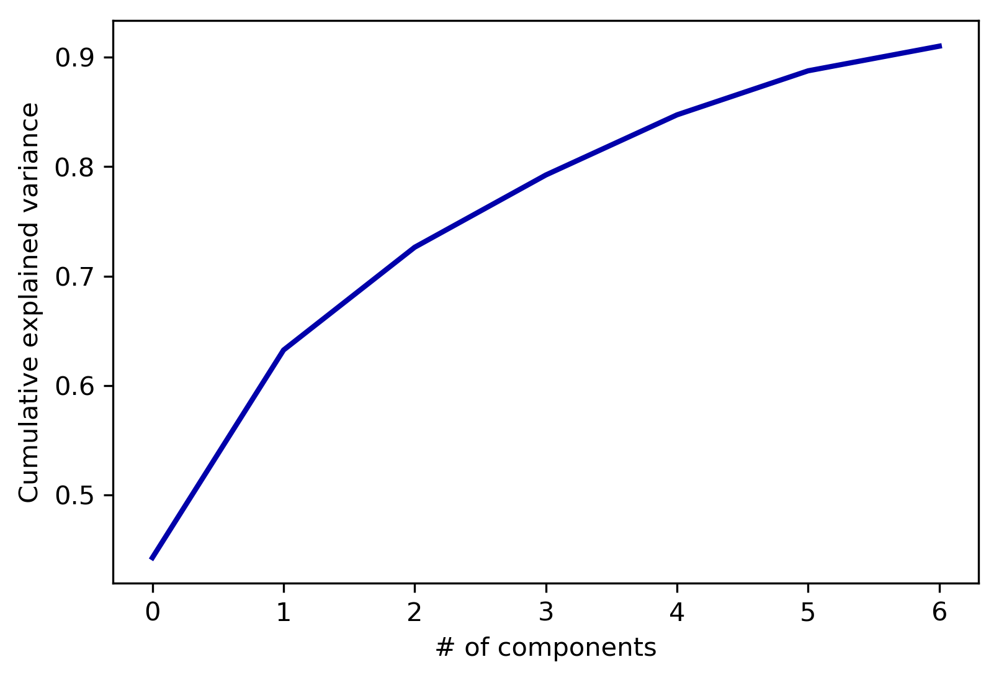

In [26]:
from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()
scaler = StandardScaler()

scaler.fit(cancer.data)
X_scaled = scaler.transform(cancer.data)

pca = PCA(n_components=0.90)
pca.fit(X_scaled)

print(pca.n_components_)
print(pca.explained_variance_ratio_)
print(np.sum(pca.explained_variance_ratio_))

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('# of components')
plt.ylabel('Cumulative explained variance')
plt.show()

In [27]:
# transform data onto the first two principal components
X_pca = pca.transform(X_scaled)
print("X_pca.shape: {}".format(X_pca.shape))

X_train, X_test, y_train, y_test = train_test_split(
    X_pca, 
    cancer.target, 
    stratify=cancer.target, 
    random_state=66
)

gbrt = GradientBoostingClassifier(random_state=0)
gbrt.fit(X_train, y_train)

print("Accuracy on training set: {:.3f}".format(gbrt.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(gbrt.score(X_test, y_test)))

X_pca.shape: (569, 7)
Accuracy on training set: 1.000
Accuracy on test set: 0.951


##### Eigenfaces for feature extraction
- PCA를 사용한 특성 추출
  - 원본 데이터 표현보다 분석하기에 더 적합한 데이터 표현을 찾을 수 있으리라는 생각에서 출발<br/><br/>

- 얼굴 이미지에서 주요 특성 추출하는 응용 제작
  - LFW (Labled Faces in the Wild) 데이터셋 활용
    - 인터넷에서 Crawling한 유명 인사(2000년 초반 이후의 정치인, 가수, 배우, 운동선수)들의 얼굴 이미지
    - 처리 속도를 높이기 위해 흑백 이미지를 사용하고 스케일을 줄임
      - fetch_lfw_people 함수 사용
      - 인자
        - color=False (기본값)
          - color가 True이면 3 RGB channels 값 유지          
        - resize=0.5 (기본값)
        - min_faces_per_person=None (기본값)
          - 각 사람 얼굴당 최소한의 이미지 개수를 지정
    - 출처: 메사추세츠 애머스트 주립대학의 Vision Lab (http://vis-www.cs.umass.edu/lfw/)

In [28]:
from sklearn.datasets import fetch_lfw_people
people = fetch_lfw_people(min_faces_per_person=20, resize=0.7)
image_shape = people.images[0].shape

print("people.images.shape: {}".format(people.images.shape))
print("An image shape: {}".format(people.images[0].shape))
print("Number of classes: {}".format(len(people.target_names)))
print()
print("people.data.shape: {}".format(people.data.shape))
print("people.target.shape: {}".format(people.target.shape))
print()
print("people.target[0]: {}".format(people.target[0]))
print("people.target_names[0]: {}".format(people.target_names[0]))

people.images.shape: (2936, 87, 65)
An image shape: (87, 65)
Number of classes: 59

people.data.shape: (2936, 5655)
people.target.shape: (2936,)

people.target[0]: 17
people.target_names[0]: Alejandro Toledo


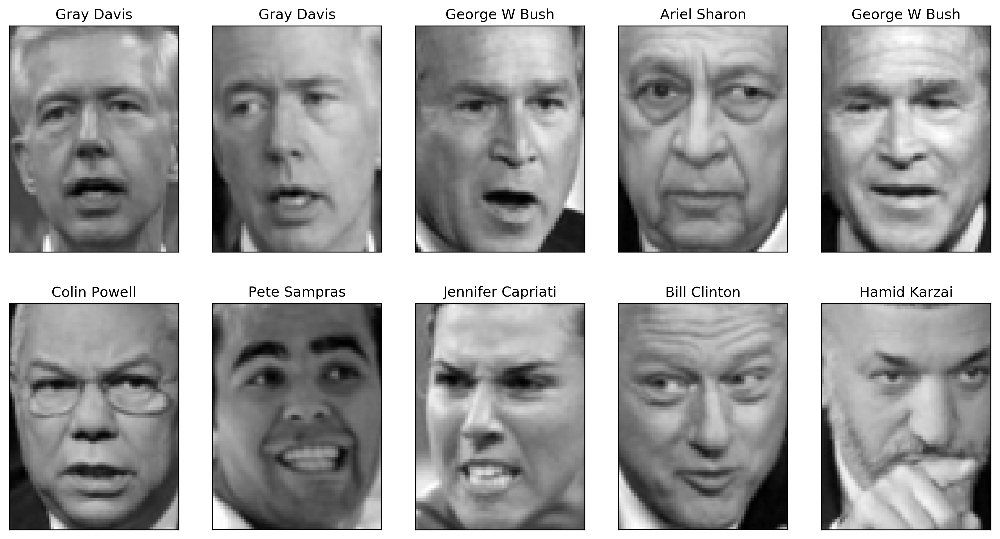

In [29]:
fig, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})

for target, image, ax in zip(people.target, people.images, axes.ravel()):
    ax.imshow(image)
    ax.set_title(people.target_names[target])

- George W Bush (530)와 Colin Powell (236)의 이미지가 많음

In [30]:
# count how often each target appears
counts = np.bincount(people.target)
print(counts)
print()
# print counts next to target names:
for i, (count, name) in enumerate(zip(counts, people.target_names)):
    print("[{0:2}] {1:23} {2:3}".format(i, name, count), end='   ')
    if (i + 1) % 3 == 0:
        print()

[ 39  35  21  36  20  77  42  24  29  21 236  31 121  22 530 109  44  26
  22  39  71  20  28  52  55  21  42  21  24  20  53  31  23  28  60  32
  41  22  41  48  29  33  20  22  22  30  27  32  26  23  52  33  23  25
  33 144  32  49  24]

[ 0] Alejandro Toledo         39   [ 1] Alvaro Uribe             35   [ 2] Amelie Mauresmo          21   
[ 3] Andre Agassi             36   [ 4] Angelina Jolie           20   [ 5] Ariel Sharon             77   
[ 6] Arnold Schwarzenegger    42   [ 7] Atal Bihari Vajpayee     24   [ 8] Bill Clinton             29   
[ 9] Carlos Menem             21   [10] Colin Powell            236   [11] David Beckham            31   
[12] Donald Rumsfeld         121   [13] George Robertson         22   [14] George W Bush           530   
[15] Gerhard Schroeder       109   [16] Gloria Macapagal Arroyo  44   [17] Gray Davis               26   
[18] Hamid Karzai             22   [19] Hans Blix                39   [20] Hugo Chavez              71   
[21] Igor Ivanov

- 데이터 집합의 편중을 없에기 위해 사람마다 최대 50개의 이미지만 선택

In [31]:
print("people.target.shape:", people.target.shape)
print()
mask = np.zeros(people.target.shape, dtype=np.bool)

print("mask.shape:", mask.shape)
print()

print("np.unique(people.target):\n{0}".format(np.unique(people.target)))
print()

for target in np.unique(people.target):
    print("np.where(people.target == {0}):\n{1}".format(target, np.where(people.target == target)))
    mask[np.where(people.target == target)[0][:50]] = 1
    print()
    
X_people = people.data[mask]
y_people = people.target[mask]

# 0~255 사이의 값을 0~1 사이의 값으로 변환 --> 그레이 스케일로 변환
X_people = X_people / 255.

people.target.shape: (2936,)

mask.shape: (2936,)

np.unique(people.target):
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 50 51 52 53 54 55 56 57 58]

np.where(people.target == 0):
(array([ 139,  199,  361,  551,  815,  944,  976, 1010, 1113, 1143, 1164,
       1249, 1383, 1466, 1502, 1658, 1667, 1679, 1741, 1805, 1815, 1852,
       1940, 1947, 1967, 2110, 2114, 2167, 2300, 2367, 2433, 2457, 2542,
       2568, 2570, 2615, 2736, 2874, 2911]),)

np.where(people.target == 1):
(array([  73,   94,  176,  221,  226,  230,  301,  305,  372,  723,  738,
        796,  800,  804,  972, 1068, 1205, 1390, 1413, 1422, 1597, 1671,
       1698, 1787, 2140, 2171, 2182, 2197, 2213, 2218, 2287, 2314, 2536,
       2555, 2840]),)

np.where(people.target == 2):
(array([ 236,  240,  373,  771,  907, 1000, 1246, 1270, 1354, 1728, 1780,
       1956, 2041, 2048, 2111, 2200, 2271, 2339, 2370, 2416, 2453])

In [32]:
print("X_people.shape:", X_people.shape)
print("y_people.shape:", y_people.shape)

X_people.shape: (1976, 5655)
y_people.shape: (1976,)


- 얼굴 분류 문제의 어려운점
  - 대표적인 Supervised Learning
  - 일반적으로 얼굴 데이터베이스에는 사람의 수는 매우 많지만 각 사람에 대한 이미지 수는 적음 (즉, 클래스별 훈련 데이터가 작음)
  - 대규모 모델을 처음부터 다시 훈련시키지 않고도 새로운 사람의 얼굴을 쉽게 추가하여 모델을 강화시킬 수 있어야 함
- KNeighborsClassifier
  - 위와 같은 문제가 존재할 때 가장 쉽게 사용할 수 있는 모델
  - n_neighbors=1
    - 클래스마다 하나의 최근접 훈련 샘플만 사용

In [33]:
from sklearn.neighbors import KNeighborsClassifier

# split the data in training and test set
# stratify parameter makes a split so that the proportion of values in the sample produced 
# will be the same as the proportion of values provided to parameter stratify.
# train_test_split은 훈련 데이터와 테스트 데이터를 기본적으로 75%:25%로 나눔

X_train, X_test, y_train, y_test = train_test_split(X_people, y_people, stratify=y_people, random_state=0)
print("X_train.shape: {}".format(X_train.shape))
print("y_train.shape: {}".format(y_train.shape))
print("X_test.shape: {}".format(X_test.shape))
print("y_test.shape: {}".format(y_test.shape))

# build a KNeighborsClassifier with using one neighbor:
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(X_train, y_train)
print("Test set score of 1-nn: {:.2f}".format(knn.score(X_test, y_test)))

X_train.shape: (1482, 5655)
y_train.shape: (1482,)
X_test.shape: (494, 5655)
y_test.shape: (494,)
Test set score of 1-nn: 0.21


- 0.23의 분류 정확도
  - 나쁜 결과는 아님
    - 무작위 분류 정확도는 1/62 = 1.6%
  - 좋은 결과도 아님
    - 두 이미지의 동일 위치 픽셀의 거리 비교 기반 --> 실제적으로 얼굴이미지를 인식하는 것과 다름
    - 동일한 두 사람 얼굴에 대해 얼굴위치가 한 픽셀만 오른쪽으로 이동해도 전혀 다른 얼굴 이미지로 인식 

- PCA with Whitening (백색화)
  - 인자: whiten=True
    - 각 주성분마다 특성값들의 스케일을 동일하게 함
    - 즉, PCA 변환 결과 각 주성분 마다 데이터 특성들이 평균이 0, 표준편차가 1이 되도록 변환
  - 일반적인 PCA 결과 데이터에 대하여 StandardScaler 적용하는 것과 동일한 효과

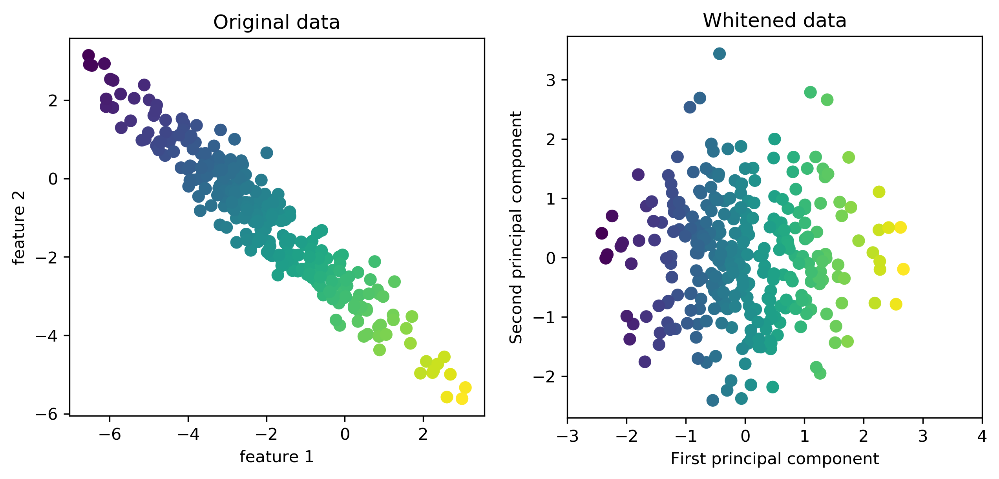

In [34]:
mglearn.plots.plot_pca_whitening()

- PCA를 이용하여 처음 원본 데이터의 5655개의 특성 종류에서 100개의 주성분을 추출 (pca.components_)
- 추출한 주성분을 활용하여 원본 데이터를 변환 
    - 주성분 행렬(100, 5655) X 원본 샘플(5655,) = 새로운 특성데이터(100,)

In [35]:
pca = PCA(n_components=100, whiten=True, random_state=0).fit(X_train)
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

print("X_train_pca.shape: {}".format(X_train_pca.shape))

X_train_pca.shape: (1482, 100)


In [36]:
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(X_train_pca, y_train)
print("Test set accuracy: {:.2f}".format(knn.score(X_test_pca, y_test)))

Test set accuracy: 0.28


- PCA 모델을 활용하여 변환한 데이터를 사용한 예측 정확도가 0.23 에서 0.31로 향상됨

In [37]:
print("pca.components_.shape: {}".format(pca.components_.shape))

pca.components_.shape: (100, 5655)


- 하지만, 활용하는 분류 모델에 따라 PCA를 활용한 예측 정확도는 달라짐
- 일반적으로 PCA로 변환된 더 낮은 차원의 데이터를 활용하면 예측 정확도는 다소 낮아짐

In [38]:
from sklearn.linear_model import LogisticRegression

lr1 = LogisticRegression(random_state=0)
lr1.fit(X_train, y_train)
print("Accuracy on test set: {:.2f}".format(lr1.score(X_test, y_test)))

lr2 = LogisticRegression(random_state=0)
lr2.fit(X_train_pca, y_train)

print("Accuracy on test set: {:.3f}".format(lr2.score(X_test_pca, y_test)))

Accuracy on test set: 0.51
Accuracy on test set: 0.445


- 이미지인 경우 주성분 시각화 가능

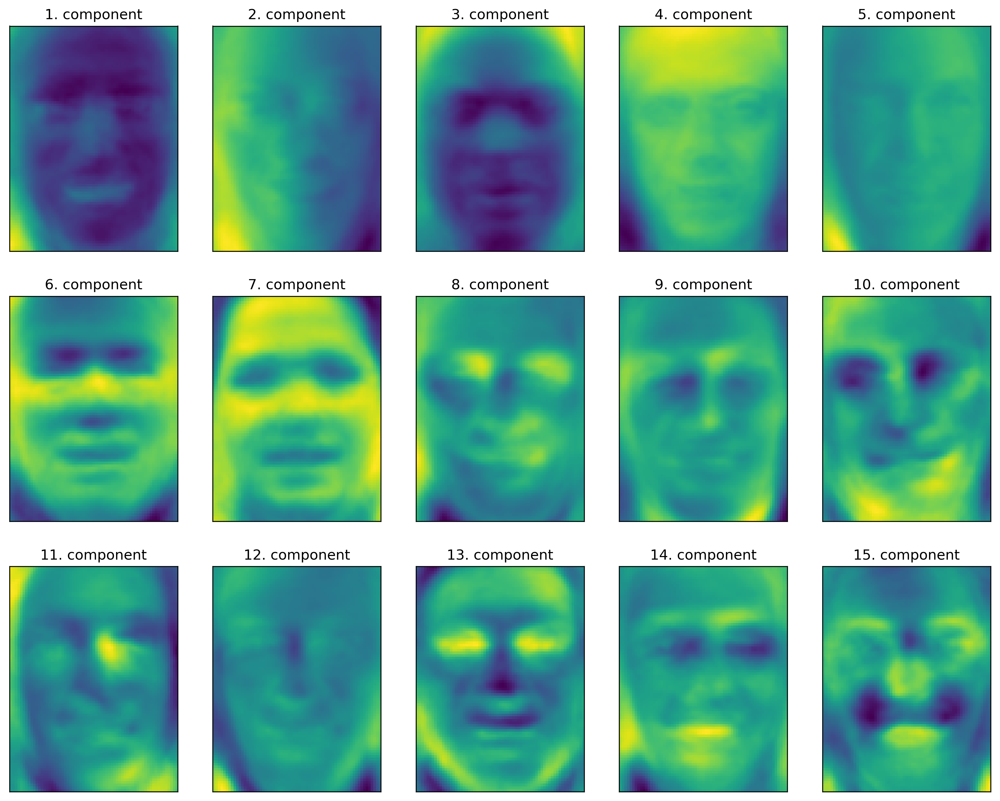

In [39]:
fig, axes = plt.subplots(3, 5, figsize=(15, 12), subplot_kw={'xticks': (), 'yticks': ()})

for i, (component, ax) in enumerate(zip(pca.components_, axes.ravel())):
    ax.imshow(component.reshape(image_shape), cmap='viridis')
    ax.set_title("{}. component".format((i + 1)))

- 주성분 1: 얼굴과 배경의 명암 차이를 기록한 것으로 추정
- 주성분 2: 오른쪽과 왼쪽의 명암 차이를 담고 있는 것으로 추정
- ...

- 주성분을 사용하여 원본 데이터를 재구성
  - 주성분 행렬(100, 5655) X 원본 샘플(5655,) = 새로운 특성데이터(100,)
  - 주성분의 전치행렬(5666, 100) X 새로운 특성데이터(100,) = 원본 샘플(5666,)

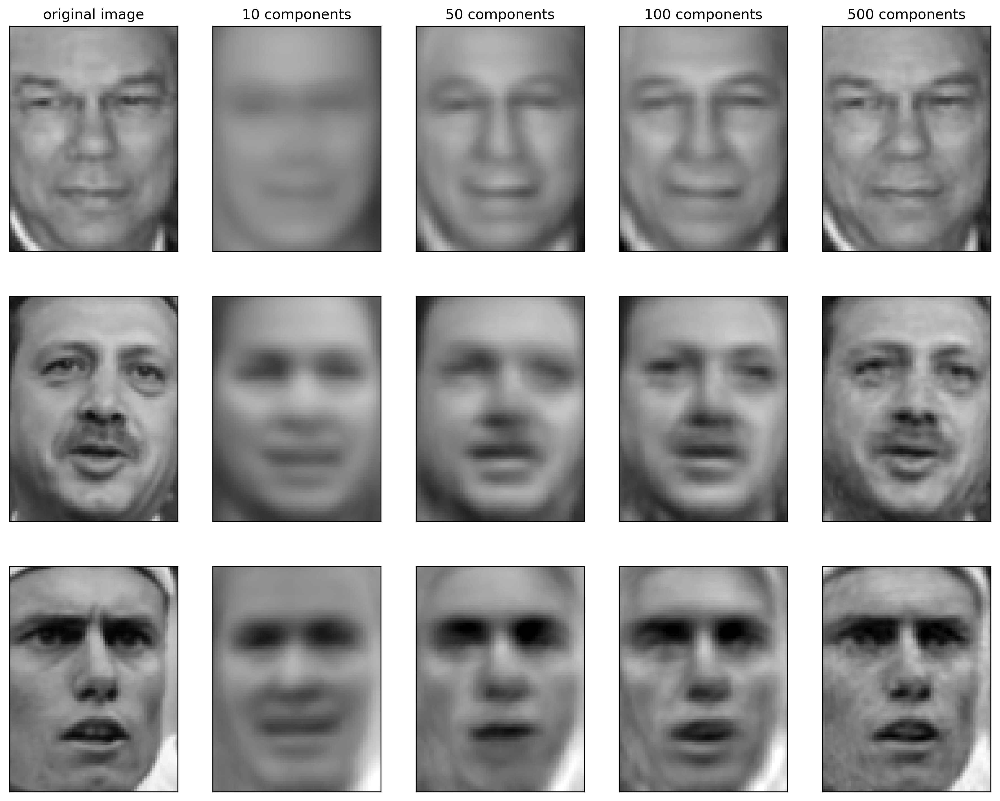

In [40]:
mglearn.plots.plot_pca_faces(X_train, X_test, image_shape)

Text(0,0.5,'Second principal component')

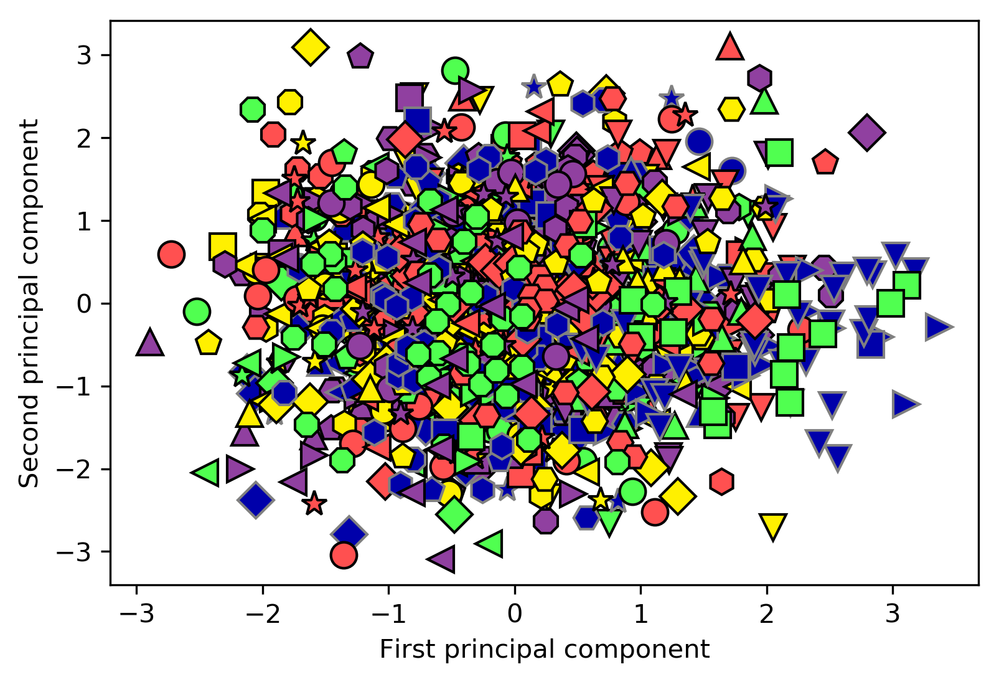

In [41]:
mglearn.discrete_scatter(X_train_pca[:, 0], X_train_pca[:, 1], y_train)
plt.xlabel("First principal component")
plt.ylabel("Second principal component")

#### 3.4.2 Non-Negative Matrix Factorization (NMF)
![Alt text](http://cfile24.uf.tistory.com/image/990F9B405A3923AF21FB8F)

- NMF
  - It is a group of algorithms where a matrix V is factorized into two matrices W and H, with the property that all three matrices have no negative elements. This non-negativity makes the resulting matrices easier to inspect. Also, in applications such as processing of audio spectrograms or muscular activity, non-negativity is inherent to the data being considered. Since the problem is not exactly solvable in general, it is commonly approximated numerically.
  - 0 또는 양수로만 구성된 W와 H만을 생성
  - W와 H의 각 원소가 음수가 아니므로 원 데이터의 특성에 음수가 없어야 함.
  - https://en.wikipedia.org/wiki/Non-negative_matrix_factorization
- NMF 활용 데이터
  - 음성/악기 오디오 데이터
  - 여러 악기 또는 음성이 섞여 있는 데이터에서 각 원본 성분들을 구분할 수 있음
- PCA vs. NMF
  - PCA
    - 음수 성분이나 계수가 만드는 효과의 이해가 어려움. 
    - 실제로 부호에는 아무런 규칙이 없음
  - NMF
    - 상대적으로 PCA보다 해석하기 쉬움.
    - 모든 주성분 사이에 원본 데이터의 특질을 더 많이 포함하는 중요도 차이가 없음 --> 즉 모든 주성분은 동등하게 중요
    - W와 H의 무작위 초기화 --> 난수 생성 초기값에 따라 결과가 달라짐

##### Applying NMF to synthetic data
- 원본 데이터 확인
  - 원본 데이터의 각 성분이 양수인지 확인하는 작업 필요
  - 각 데이터가 원점 (0,0)에서 상대적으로 어디에 놓여 있는가가 중요.
  - 즉, 원점 (0,0)에서 데이터가 가는 방향을 추출한 것으로 음수미포함 성분을 이해 가능<br/><br/>  

- NMF 알고리즘
  - $V$: 원본 데이터 행렬
  - $W$: 새롭게 변환된 행렬
  - $H$: 주성분 행렬
  - the approximation of $V$ by $V \simeq WH$ is achieved by minimizing the error function $$\min_{W,H}|| V-WH ||_{F},~subject~to~W\geq 0, H\geq 0$$.
  - 아래 논문을 활용하여 위와 같은 최적화 문제 해결
    - Daniel D. Lee & H. Sebastian Seung (2001). Algorithms for Non-negative Matrix Factorization (PDF). Advances in Neural Information Processing Systems 13: Proceedings of the 2000 Conference. MIT Press. pp. 556–562.
    - 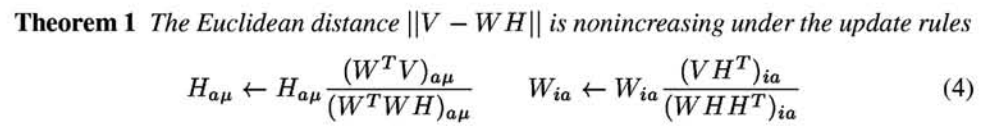

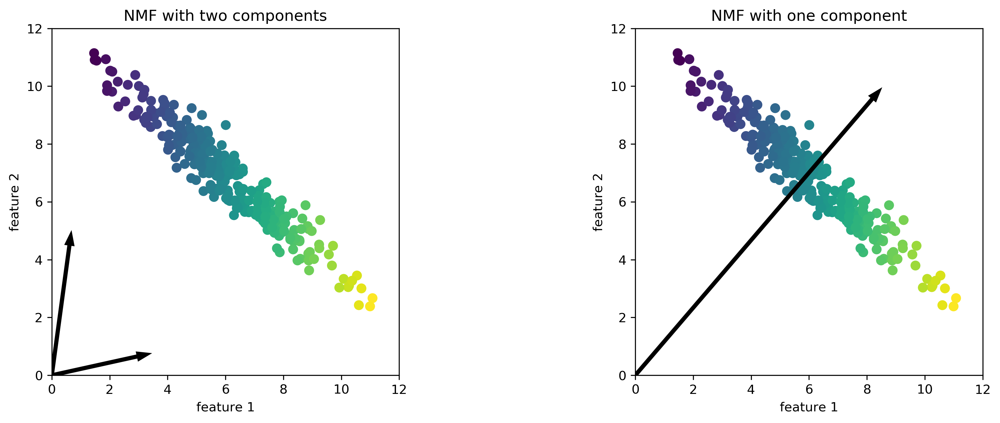

In [42]:
mglearn.plots.plot_nmf_illustration()

- 첫번째 그래프
  - 주성분 2개
    - 데이터의 각 특성마다 끝에 위치한 포인트를 가리키는 방향으로 주성분 구성
    - 총 100개의 원본 데이터: Shape (100, 2)에 대한 행렬 분해 결과
      - V (100 x 2) = W (100 x 2) x H (2 x 2)
  - 새롭게 변환된 특성 데이터: W (100 x 2)
- 두번째 그래프
  - 주성분 1개
    - 데이터를 가장 잘 표현하는 각 특성마다 평균값으로 향하는 주성분을 구성
    - 총 100개의 원본 데이터: Shape (100, 2)에 대한 행렬 분해 결과
      - V (100 x 2) = W (100 x 1) x H (1 x 2)
  - 새롭게 변환된 특성 데이터: W (100 x 1)

##### Applying NMF to face images

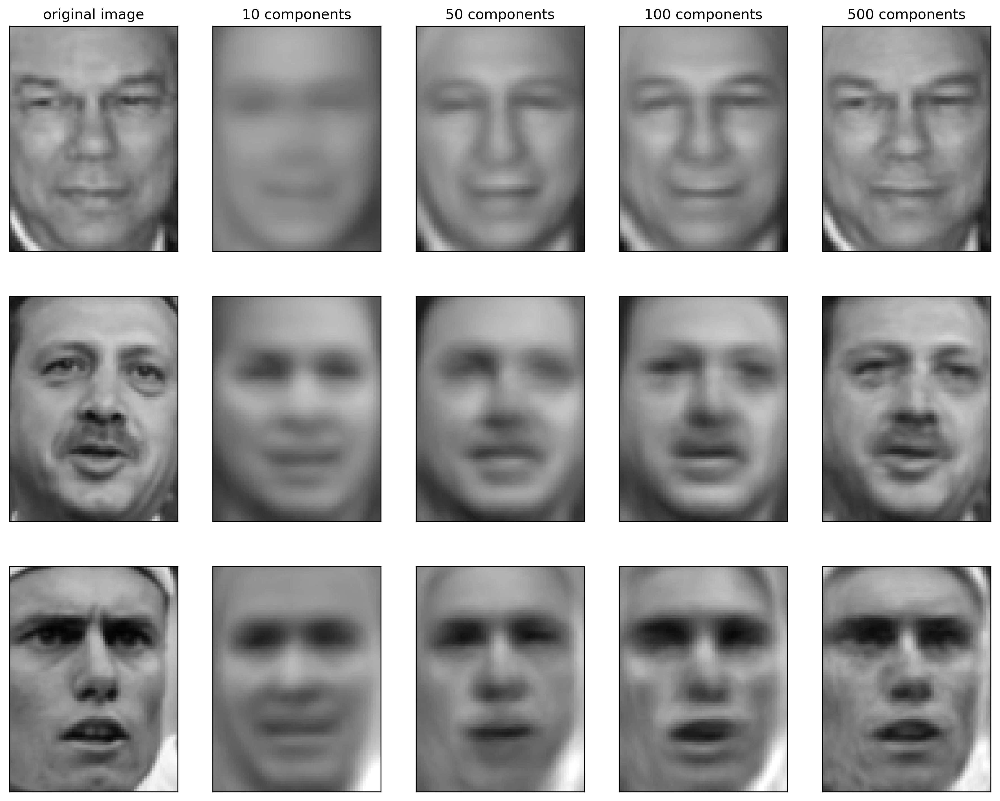

In [43]:
mglearn.plots.plot_nmf_faces(X_train, X_test, image_shape)

- 훈련 데이터에 대한 비음수 분해: V = WH
  - 원본 훈련 데이터 1,482개 V: Shape - (1486, 5655)
  - 새롭게 변환된 행렬 W: Shape - (1486, 15)
  - 주성분 데이터 H: Shape - (15, 5655)
<br/>
- 테스트 데이터에 대한 비음수 분해: V=WH
  - 원본 테스트 데이터 494개 V: Shape - (494, 5655)
  - 새롭게 변환된 행렬 W: Shape - (494, 15)
  - 주성분 데이터 H: Shape - (15, 5655)
<br/>  
- [주의] 훈련 데이터에 대한 Fit 이후 테스트 데이터에 대한 Transform
  - NMF는 Fit에 대한 의미없음
    - https://github.com/scikit-learn/scikit-learn/blob/a24c8b46/sklearn/decomposition/nmf.py#L1246
  - Transform 이 호출될 때 주어진 데이터에 대한 NMF 분해 시작하여 Transform의 반환값으로 W를 반환함.

Transformed Train Data Shape: (1482, 15)
Transformed Test Data Shape: (494, 15)


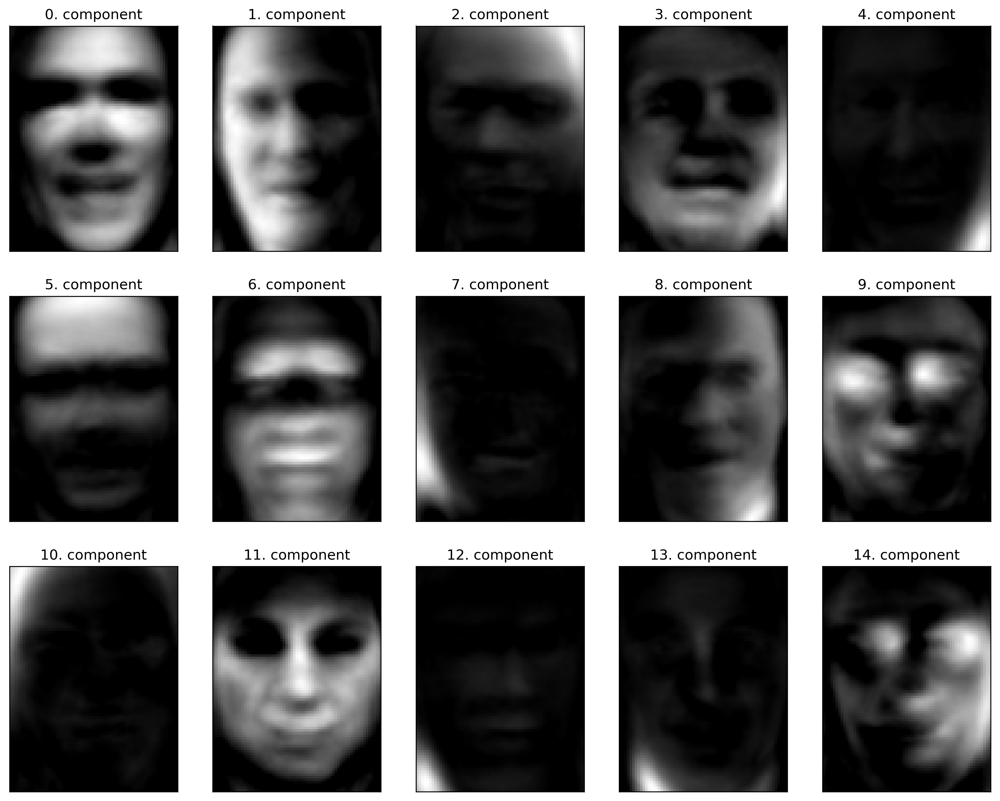

In [96]:
from sklearn.decomposition import NMF
nmf = NMF(n_components=15, random_state=0)
nmf.fit(X_train)
X_train_nmf = nmf.transform(X_train)
X_test_nmf = nmf.transform(X_test)

print("Transformed Train Data Shape:", X_train_nmf.shape)
print("Transformed Test Data Shape:", X_test_nmf.shape)

fig, axes = plt.subplots(3, 5, figsize=(15, 12), subplot_kw={'xticks': (), 'yticks': ()})
for i, (component, ax) in enumerate(zip(nmf.components_, axes.ravel())):
    ax.imshow(component.reshape(image_shape))
    ax.set_title("{}. component".format(i))

- 주성분 0~14 중 하나를 선택 --> compn 변수에 할당
- NMF 알고리즘에 의하여 변환된 훈련 데이터: W (1486, 15)
- 변환된 훈련 데이터의 각 특성중 compn 위치 값이 가장 큰 10개 선택하여 해당 10개에 대한 원본 데이터를 이미지 형태로 출력

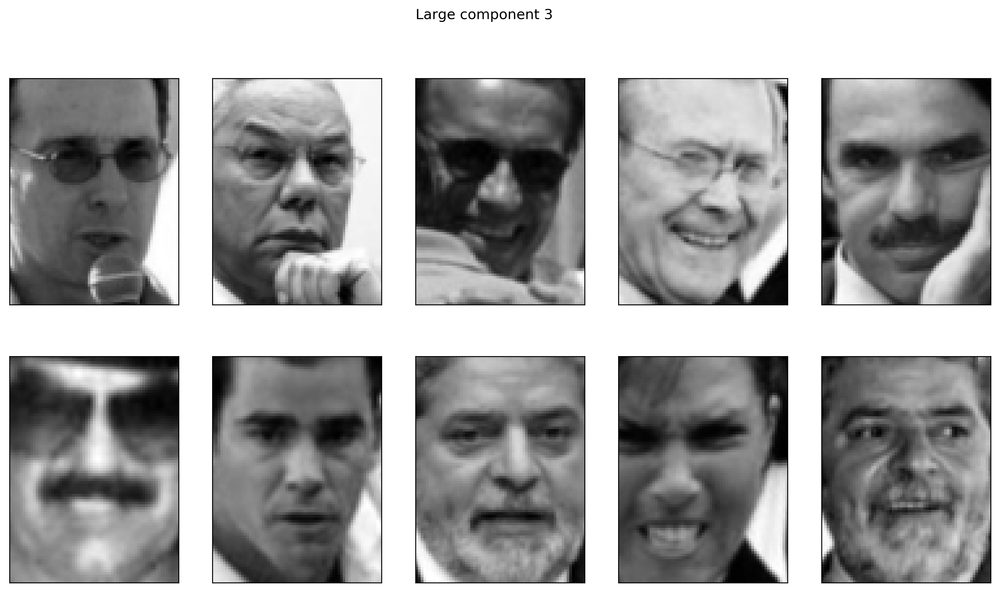

In [45]:
compn = 3
# sort by 3rd component, plot first 10 images
inds = np.argsort(X_train_nmf[:, compn])[::-1]
fig, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
fig.suptitle("Large component 3")
for i, (ind, ax) in enumerate(zip(inds, axes.ravel())):
    ax.imshow(X_train[ind].reshape(image_shape))

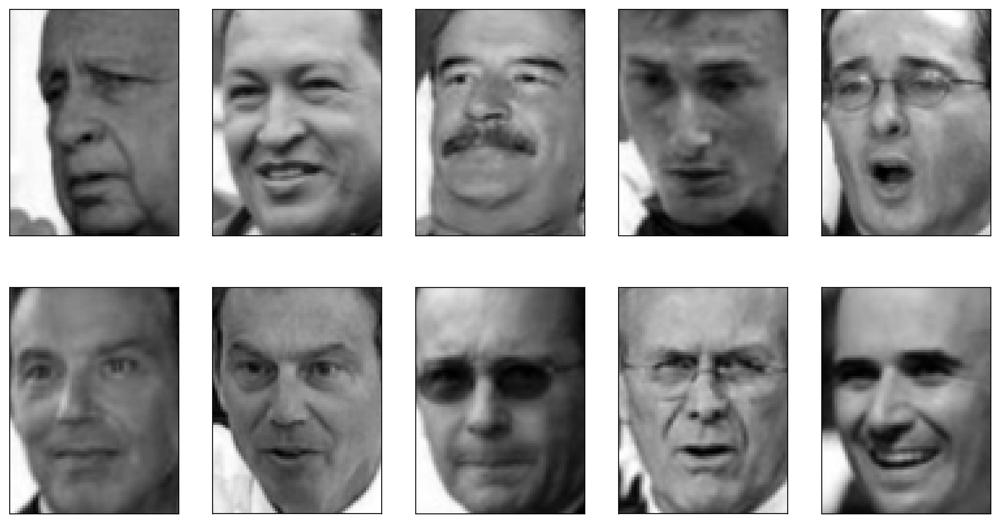

In [46]:
compn = 7
# sort by 7th component, plot first 10 images
inds = np.argsort(X_train_nmf[:, compn])[::-1]
fig.suptitle("Large component 7")
fig, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
for i, (ind, ax) in enumerate(zip(inds, axes.ravel())):
    ax.imshow(X_train[ind].reshape(image_shape))

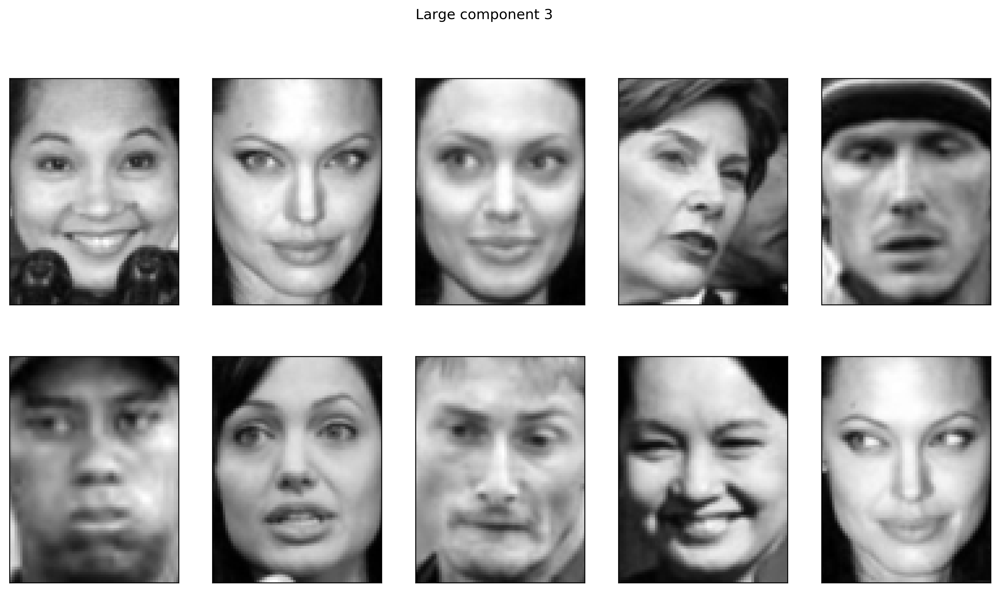

In [47]:
compn = 11
# sort by 3rd component, plot first 10 images
inds = np.argsort(X_train_nmf[:, compn])[::-1]
fig, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
fig.suptitle("Large component 3")
for i, (ind, ax) in enumerate(zip(inds, axes.ravel())):
    ax.imshow(X_train[ind].reshape(image_shape))

Shape of S: (2000, 3)
2.65408202773
2.48908886898
1.07757432949



Text(0,0.5,'Signal')

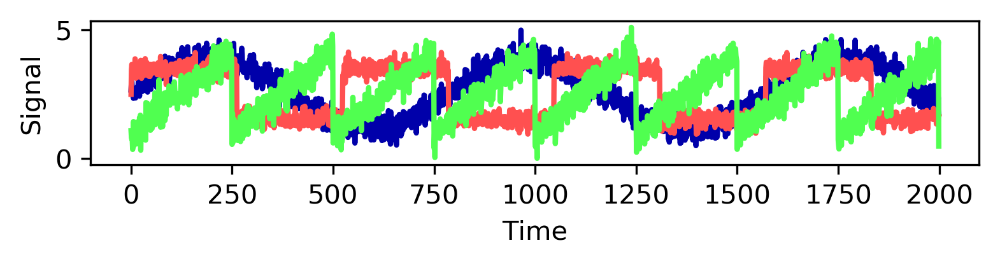

In [99]:
S = mglearn.datasets.make_signals()
print("Shape of S: {}".format(S.shape))
print(S[0][0])
print(S[0][1])
print(S[0][2])
print()

plt.figure(figsize=(6, 1))
plt.plot(S, '-')
plt.xlabel("Time")
plt.ylabel("Signal")

Shape of S: (2000, 3)
Shape of A: (100, 3)
0.548813503927
0.715189366372
0.602763376072

0.544883182997
0.423654799339
0.645894113067

Shape of X (=S * A.T): (2000, 100)


Text(0,0.5,'Measurements')

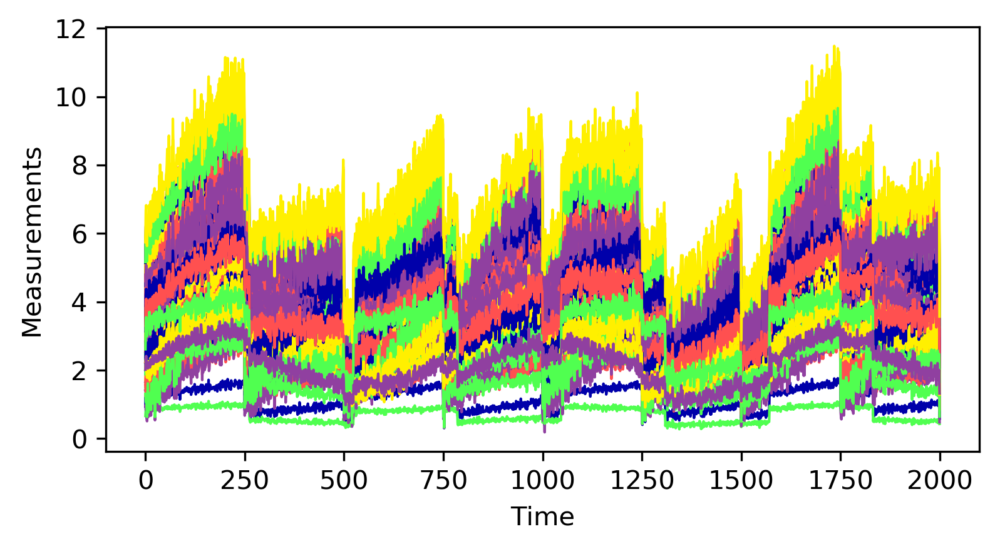

In [102]:
print("Shape of S: {}".format(S.shape))

# Mix data into a 100 dimensional state
A = np.random.RandomState(0).uniform(size=(100, 3))
print("Shape of A: {}".format(A.shape))
print(A[0][0])
print(A[0][1])
print(A[0][2])
print()
print(A[1][0])
print(A[1][1])
print(A[1][2])
print()

X = np.dot(S, A.T)
print("Shape of X (=S * A.T): {}".format(X.shape))

plt.figure(figsize=(6, 3))
plt.plot(X, '-', linewidth=1.0)
plt.xlabel("Time")
plt.ylabel("Measurements")

In [50]:
nmf = NMF(n_components=3, random_state=42)
S_ = nmf.fit_transform(X)
print("NMF - Recovered signal shape: {}".format(S_.shape))

NMF - Recovered signal shape: (2000, 3)


In [51]:
pca = PCA(n_components=3)
H = pca.fit_transform(X)
print("PCA - Recovered signal shape: {}".format(H.shape))

PCA - Recovered signal shape: (2000, 3)


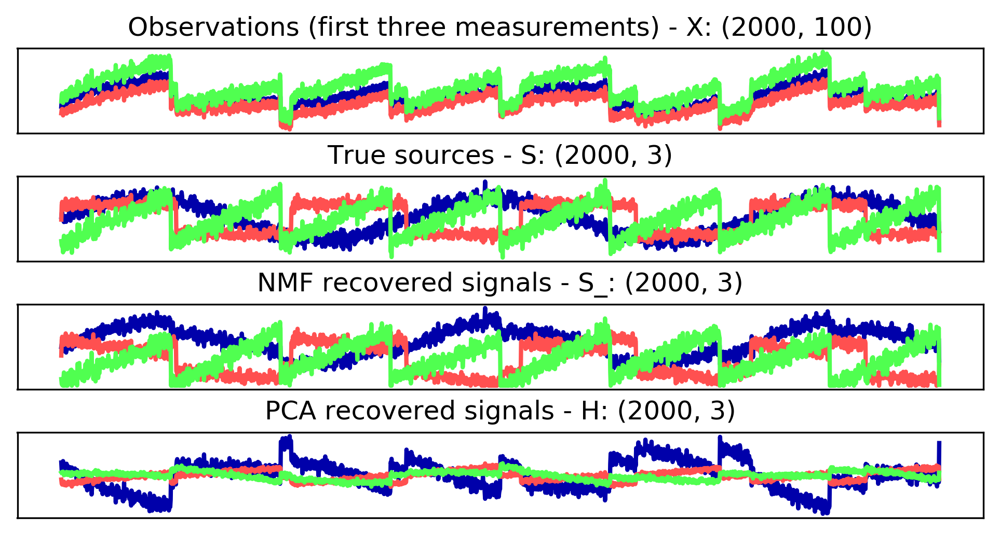

In [52]:
models = [X, S, S_, H]
names = ['Observations (first three measurements) - X: (2000, 100)',
         'True sources - S: (2000, 3)',
         'NMF recovered signals - S_: (2000, 3)',
         'PCA recovered signals - H: (2000, 3)']

fig, axes = plt.subplots(4, figsize=(8, 4), gridspec_kw={'hspace': .5}, subplot_kw={'xticks': (), 'yticks': ()})

for model, name, ax in zip(models, names, axes):
    ax.set_title(name)
    ax.plot(model[:, :3], '-')

#### 3.4.3 Manifold Learning with t-SNE
- Manifold (다양체)
  - In mathematics, a manifold is a topological space that locally resembles Euclidean space near each point.
  - 국소적으로 유클리드 공간과 닮은 위상 공간<br/><br/>
  
- Manifold Learning $\sim$ Nonlinear dimensionality reduction
  - 시각화가 주 목적
  - 주성분으로 2개 (또는 3개)만 주로 산출
    - 기존 원본 데이터 포인트 사이의 거리를 가장 잘 보존하는 2차원 표현을 찾는 것
  - 대표적인 알고리즘: t-SNE (Stochastic Neighbor Embedding)
    - 1) 각 원본 데이터를 2차원 공간에 무작위로 표현
    - 2) 원본 특성 공간에서 가까운 포인트는 보다 가깝게, 멀리 떨어진 포인트는 보다 멀어지게 만듦
    - 3) 멀리 떨어진 포인트들간의 거리를 보존하는 것보다 가까이 있는 포인트에 더 많은 비중을 둠.
  - 탐색적 데이터 분석에 활용

- scikit-learn의 손글씨 데이터셋
  - 1797개의 8x8 흑백 숫자 이미지

digits.data.shape: (1797, 64)


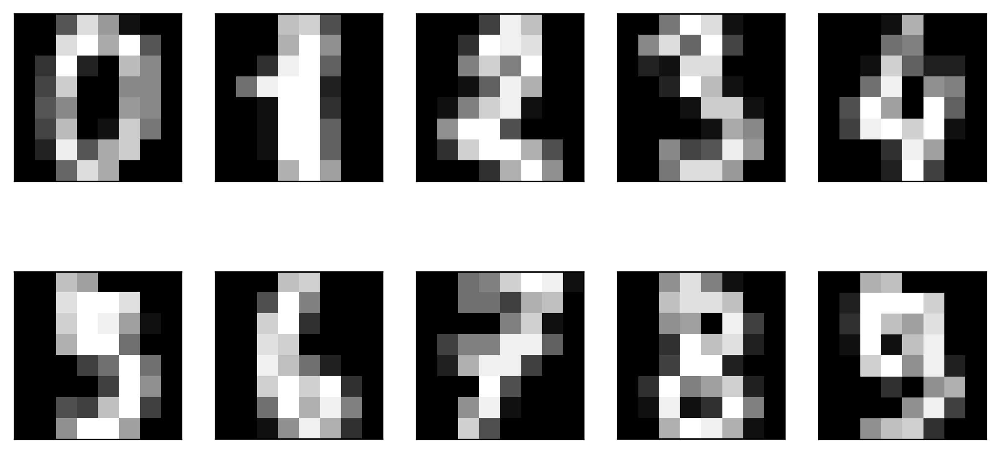

In [53]:
from sklearn.datasets import load_digits
digits = load_digits()
print("digits.data.shape: {0}".format(digits.data.shape))

fig, axes = plt.subplots(2, 5, figsize=(10, 5), subplot_kw={'xticks':(), 'yticks': ()})
for ax, img in zip(axes.ravel(), digits.images):
    ax.imshow(img)

In [106]:
# build a PCA model
pca = PCA(n_components=2)
pca.fit(digits.data)
# transform the digits data onto the first two principal components
digits_pca = pca.transform(digits.data)

Text(0,0.5,'Second principal component')

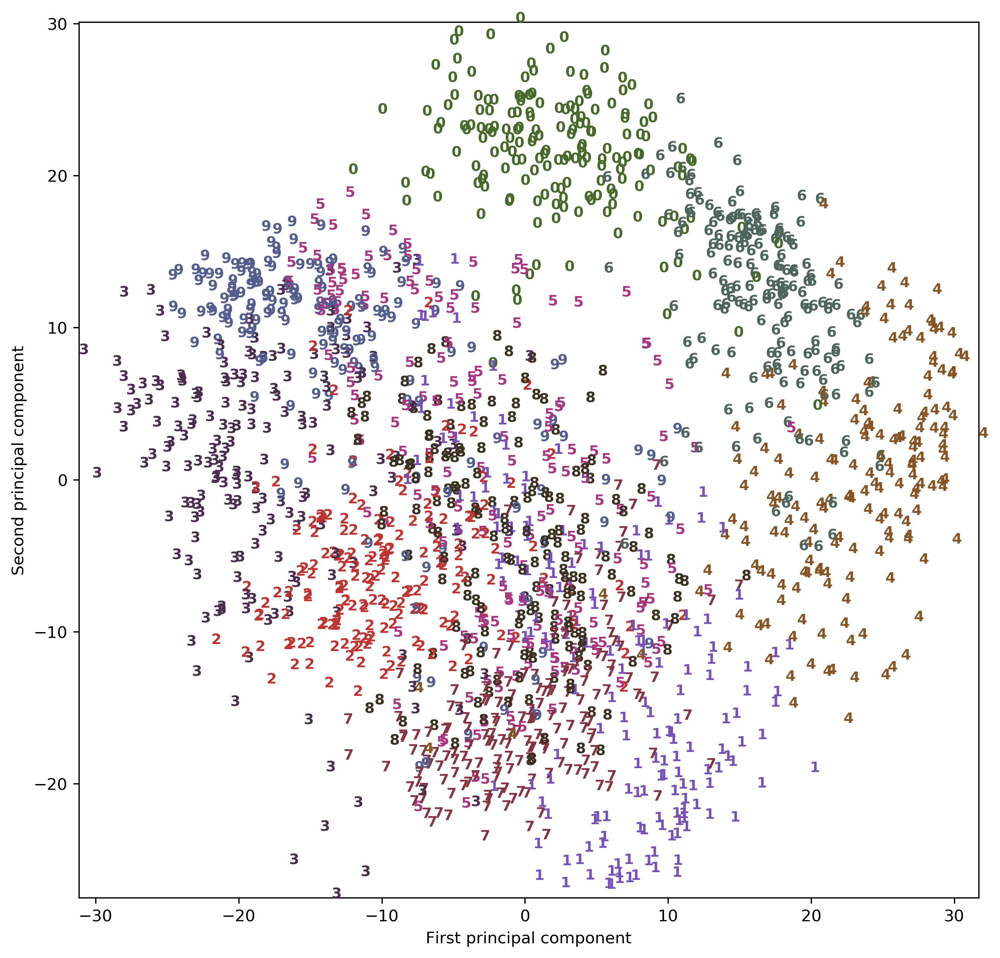

In [107]:
colors = ["#476A2A", "#7851B8", "#BD3430", "#4A2D4E", "#875525",
          "#A83683", "#4E655E", "#853541", "#3A3120", "#535D8E"]
plt.figure(figsize=(10, 10))
plt.xlim(digits_pca[:, 0].min(), digits_pca[:, 0].max())
plt.ylim(digits_pca[:, 1].min(), digits_pca[:, 1].max())
for i in range(len(digits.data)):
    # actually plot the digits as text instead of using scatter
    plt.text(digits_pca[i, 0], digits_pca[i, 1], 
             str(digits.target[i]),
             color = colors[digits.target[i]],
             fontdict={'weight': 'bold', 'size': 9})
plt.xlabel("First principal component")
plt.ylabel("Second principal component")

In [108]:
from sklearn.manifold import TSNE
tsne = TSNE(random_state=42)
# use fit_transform instead of fit, as TSNE has no transform method
digits_tsne = tsne.fit_transform(digits.data)

Text(0.5,0,'t-SNE feature 1')

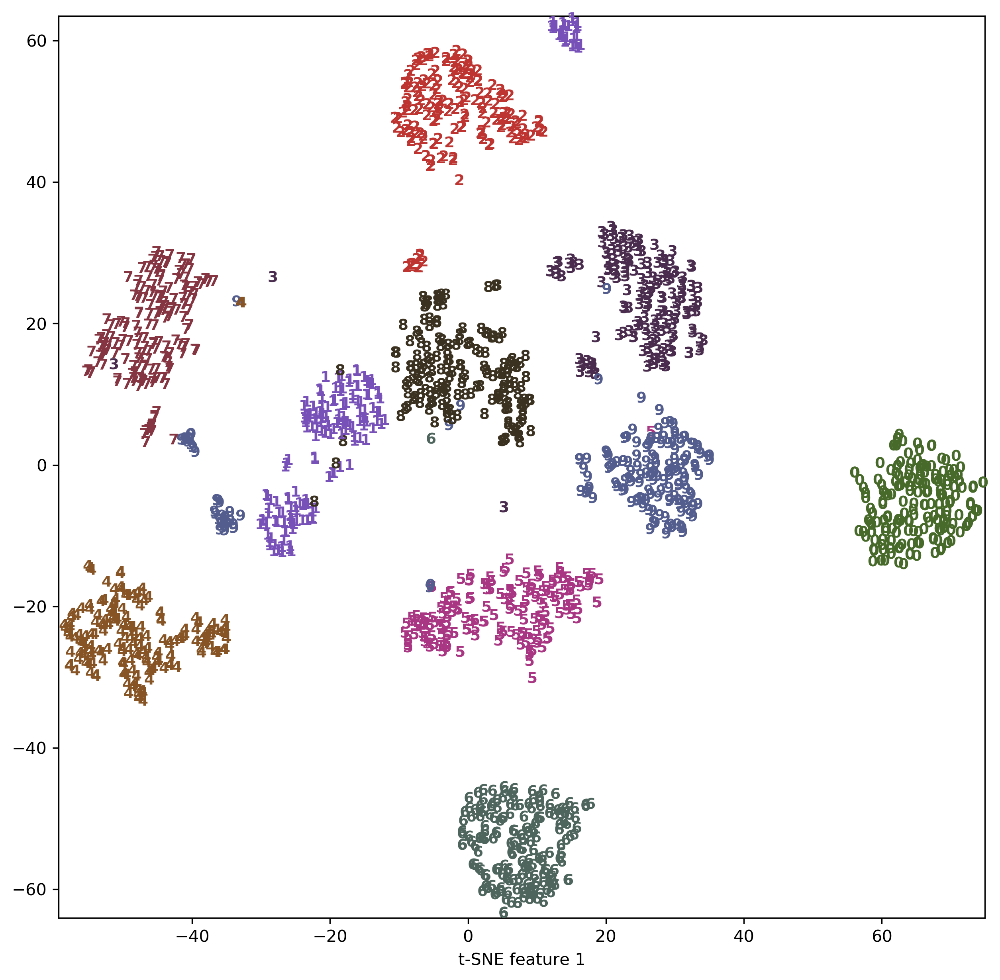

In [109]:
plt.figure(figsize=(10, 10))
plt.xlim(digits_tsne[:, 0].min(), digits_tsne[:, 0].max() + 1)
plt.ylim(digits_tsne[:, 1].min(), digits_tsne[:, 1].max() + 1)
for i in range(len(digits.data)):
    # actually plot the digits as text instead of using scatter
    plt.text(digits_tsne[i, 0], digits_tsne[i, 1], 
             str(digits.target[i]),
             color = colors[digits.target[i]],
             fontdict={'weight': 'bold', 'size': 9})
plt.xlabel("t-SNE feature 0")
plt.xlabel("t-SNE feature 1")

- cancer 데이터에 대한 TSNE

In [110]:
cancer = load_breast_cancer()

cancer_tsne = TSNE(random_state=42)
cancer_data_tsne = tsne.fit_transform(cancer.data)

Text(0.5,0,'t-SNE feature 1')

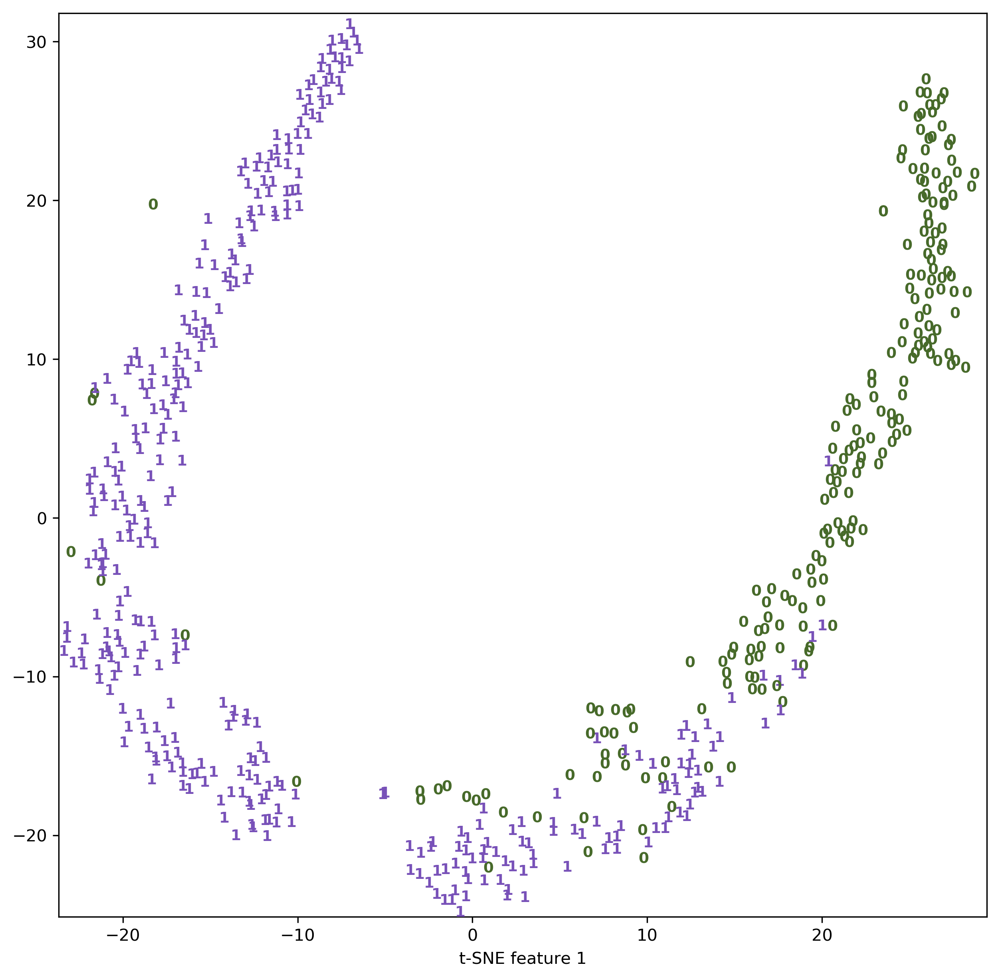

In [111]:
plt.figure(figsize=(10, 10))
plt.xlim(cancer_data_tsne[:, 0].min(), cancer_data_tsne[:, 0].max() + 1)
plt.ylim(cancer_data_tsne[:, 1].min(), cancer_data_tsne[:, 1].max() + 1)
for i in range(len(cancer.data)):
    # actually plot the digits as text instead of using scatter
    plt.text(cancer_data_tsne[i, 0], cancer_data_tsne[i, 1], 
             str(cancer.target[i]),
             color = colors[cancer.target[i]],
             fontdict={'weight': 'bold', 'size': 9})
plt.xlabel("t-SNE feature 0")
plt.xlabel("t-SNE feature 1")

### 3.5. Clustering

#### 3.5.1 k-Means clustering

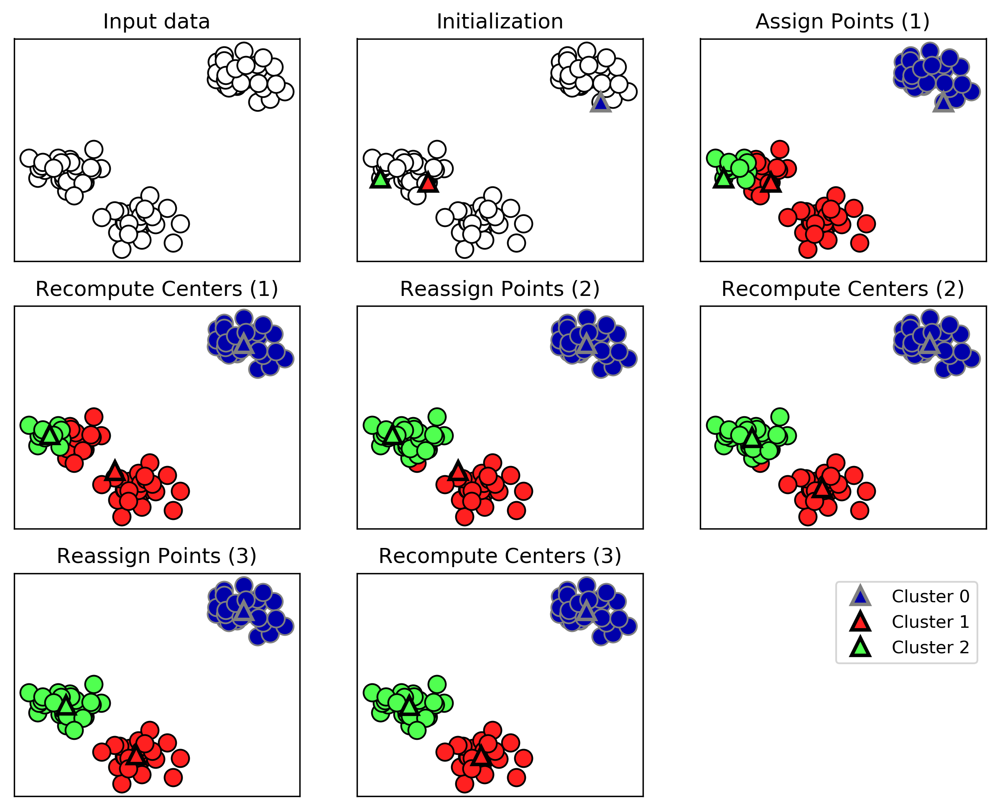

In [57]:
mglearn.plots.plot_kmeans_algorithm()

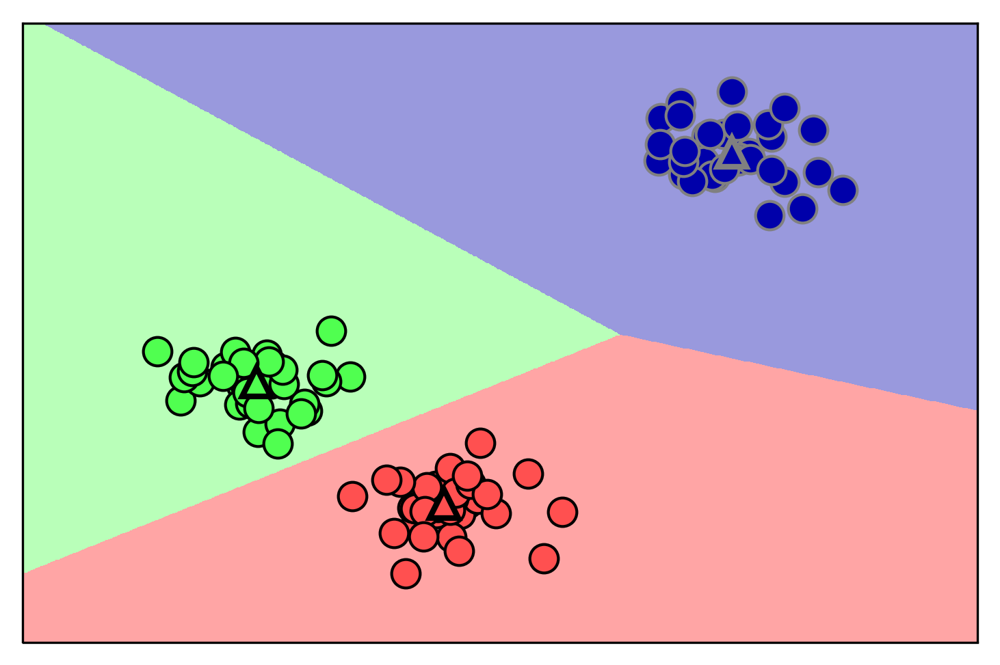

In [58]:
mglearn.plots.plot_kmeans_boundaries()

In [59]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans

# generate synthetic two-dimensional data
X, y = make_blobs(random_state=1)
print(X[0], X[1], X[2])
print(y[0], y[1], y[2])

# build the clustering model
kmeans = KMeans(n_clusters=3)
kmeans.fit(X)

[-0.794  2.105] [-9.152 -4.813] [-11.442  -4.458]
0 1 1


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [60]:
print("Cluster memberships:\n{}".format(kmeans.labels_))

Cluster memberships:
[0 1 1 1 2 2 2 1 0 0 1 1 2 0 2 2 2 0 1 1 2 1 2 0 1 2 2 0 0 2 0 0 2 0 1 2 1
 1 1 2 2 1 0 1 1 2 0 0 0 0 1 2 2 2 0 2 1 1 0 0 1 2 2 1 1 2 0 2 0 1 1 1 2 0
 0 1 2 2 0 1 0 1 1 2 0 0 0 0 1 0 2 0 0 1 1 2 2 0 2 0]


In [61]:
print("Cluster memberships:\n{}".format(kmeans.predict(X)))

Cluster memberships:
[0 1 1 1 2 2 2 1 0 0 1 1 2 0 2 2 2 0 1 1 2 1 2 0 1 2 2 0 0 2 0 0 2 0 1 2 1
 1 1 2 2 1 0 1 1 2 0 0 0 0 1 2 2 2 0 2 1 1 0 0 1 2 2 1 1 2 0 2 0 1 1 1 2 0
 0 1 2 2 0 1 0 1 1 2 0 0 0 0 1 0 2 0 0 1 1 2 2 0 2 0]


[[ -1.471   4.337]
 [-10.049  -3.86 ]
 [ -6.582  -8.172]]


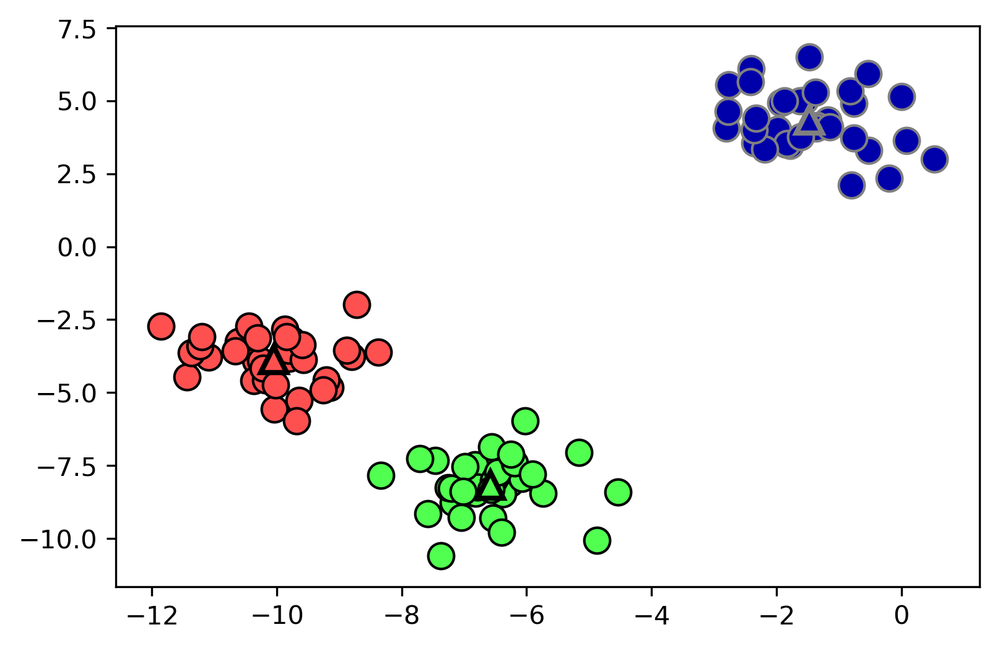

In [62]:
mglearn.discrete_scatter(X[:, 0], X[:, 1], kmeans.labels_, markers='o')

print(kmeans.cluster_centers_)

mglearn.discrete_scatter(
    kmeans.cluster_centers_[:, 0], 
    kmeans.cluster_centers_[:, 1], 
    [0, 1, 2],
    markers='^', 
    markeredgewidth=2
)

- 클래스터 수를 2로 제한하거나 5로 늘림

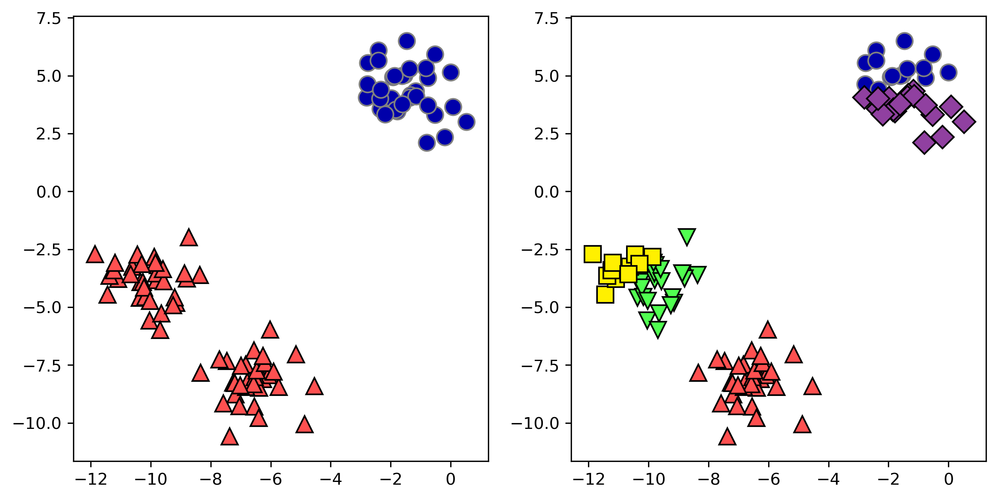

In [63]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# using two cluster centers:
kmeans = KMeans(n_clusters=2)
kmeans.fit(X)
assignments = kmeans.labels_

mglearn.discrete_scatter(X[:, 0], X[:, 1], assignments, ax=axes[0])

# using five cluster centers:
kmeans = KMeans(n_clusters=5)
kmeans.fit(X)
assignments = kmeans.labels_

mglearn.discrete_scatter(X[:, 0], X[:, 1], assignments, ax=axes[1])

##### Failure cases of k-Means

- k-Means는 클러스터 중심 사이에 정확히 중간에 Decision Boundary를 긋는다.
- fit_predict
  - 훈련 데이터 셋트로 클러스터를 구성하고 각 데이터 포인트마다 구성된 클러스터의 소속 정보를 얻기 위한 함수

Text(0,0.5,'Feature 1')

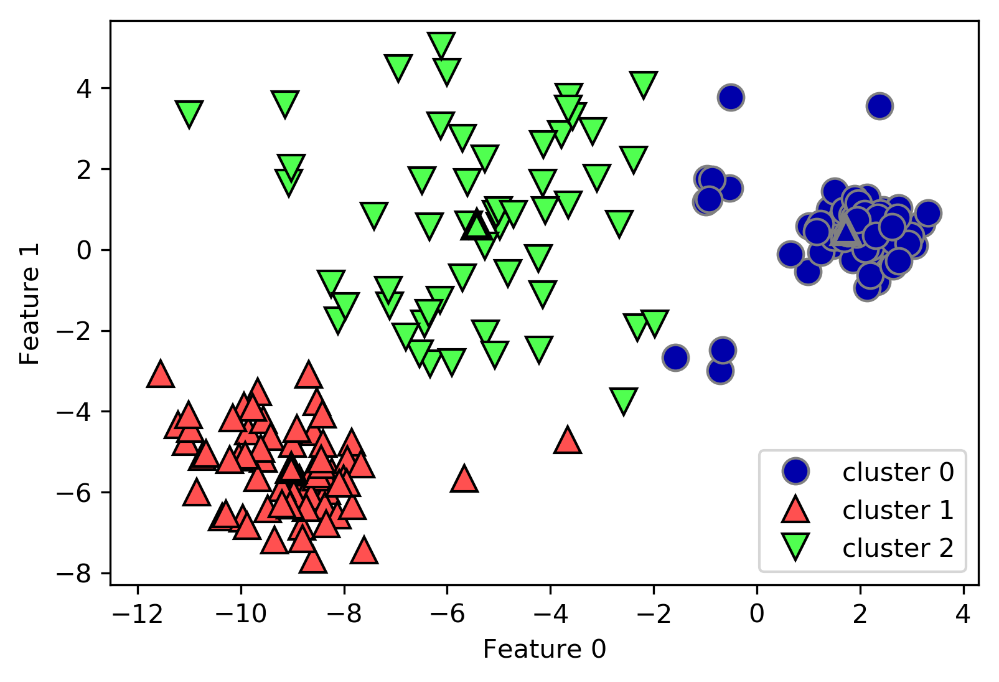

In [64]:
X_varied, y_varied = make_blobs(n_samples=200,
                                cluster_std=[1.0, 2.5, 0.5],
                                random_state=170)

kmeans = KMeans(n_clusters=3, random_state=0)

y_pred = kmeans.fit_predict(X_varied)

mglearn.discrete_scatter(X_varied[:, 0], X_varied[:, 1], y_pred)

mglearn.discrete_scatter(
    kmeans.cluster_centers_[:, 0], 
    kmeans.cluster_centers_[:, 1], 
    [0, 1, 2],
    markers='^', 
    markeredgewidth=2
)

plt.legend(["cluster 0", "cluster 1", "cluster 2"], loc='best')
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

- k-Means에서는 클러스터에서 모든 방향이 동일하게 중요하게 간주됨

In [65]:
# generate some random cluster data
X, y = make_blobs(random_state=170, n_samples=600)
rng = np.random.RandomState(74)

# transform the data to be stretched
transformation = rng.normal(size=(2, 2))
print(transformation)
X = np.dot(X, transformation)

[[ 0.608 -0.637]
 [-0.409  0.853]]


Text(0,0.5,'Feature 1')

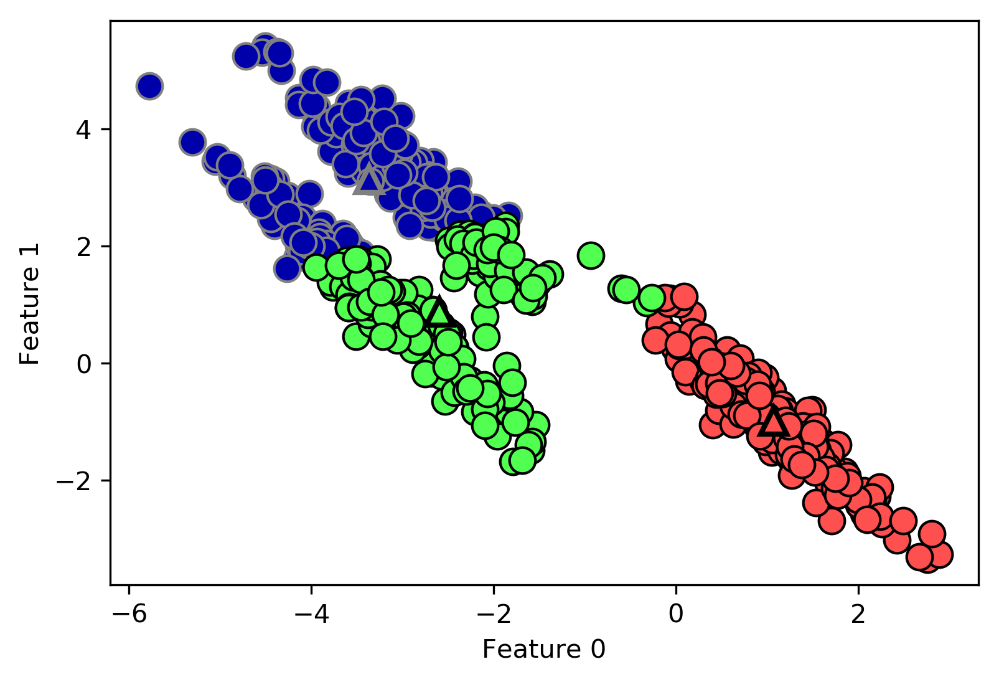

In [66]:
# cluster the data into three clusters
kmeans = KMeans(n_clusters=3)
kmeans.fit(X)
y_pred = kmeans.predict(X)

# plot the cluster assignments and cluster centers
mglearn.discrete_scatter(X[:, 0], X[:, 1], kmeans.labels_, markers='o')

mglearn.discrete_scatter(
    kmeans.cluster_centers_[:, 0], 
    kmeans.cluster_centers_[:, 1], 
    [0, 1, 2],
    markers='^', 
    markeredgewidth=2
)

plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

- 데이터 분포 형태가 복잡하다면 k-Means의 클러스터링 성능은 매우 나빠짐

Text(0,0.5,'Feature 1')

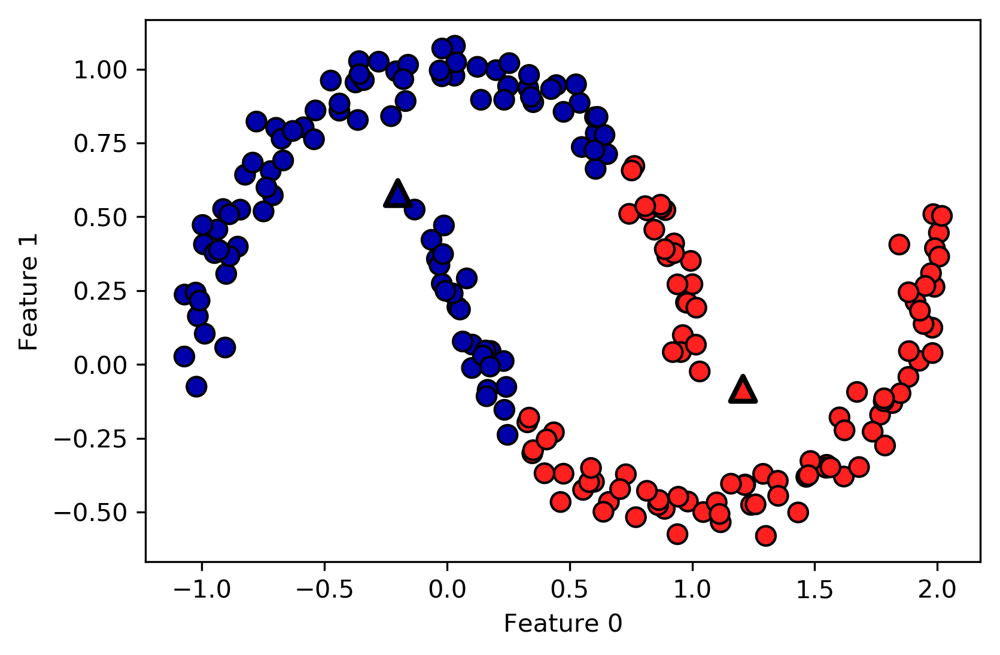

In [67]:
# generate synthetic two_moons data (with less noise this time)
from sklearn.datasets import make_moons
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# cluster the data into two clusters
kmeans = KMeans(n_clusters=2)
kmeans.fit(X)
y_pred = kmeans.predict(X)

# plot the cluster assignments and cluster centers
plt.scatter(X[:, 0], X[:, 1], c=y_pred, cmap=mglearn.cm2, s=60, edgecolor='k')

plt.scatter(
    kmeans.cluster_centers_[:, 0], 
    kmeans.cluster_centers_[:, 1],
    marker='^', 
    c=[mglearn.cm2(0), mglearn.cm2(1)], 
    s=100, 
    linewidth=2,
    edgecolor='k'
)

plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

##### Vector Quantization (or Seeing k-Means as Decomposition)
- k-Means는 각 클러스터들의 중심이 해당 클러스터에 속한 데이터들을 대표한다고 간주할 수 있음
- 이렇게 각각의 데이터가 하나의 요소로 요약되는 상황을 Vector Quantization (벡터 양자화)라고 함
- [Note] Quantization
  - In mathematics and digital signal processing, it is the process of mapping input values from a large set (often a continuous set) to output values in a (countable) smaller set. 
- [Note] Vector Quantization
  - It works by mapping a large set of points (vectors) into groups having approximately the same number of points closest to them. 

In [68]:
X_train, X_test, y_train, y_test = train_test_split(
    X_people, y_people, stratify=y_people, random_state=0)

print("X_train.shape: {}".format(X_train.shape))
print("y_train.shape: {}".format(y_train.shape))
print("X_test.shape: {}".format(X_test.shape))
print("y_test.shape: {}".format(y_test.shape))

X_train.shape: (1482, 5655)
y_train.shape: (1482,)
X_test.shape: (494, 5655)
y_test.shape: (494,)


In [69]:
nmf = NMF(n_components=100, random_state=0)
nmf.fit(X_train)

pca = PCA(n_components=100, random_state=0)
pca.fit(X_train)

kmeans = KMeans(n_clusters=100, random_state=0)
kmeans.fit(X_train)

X_reconstructed_pca = pca.inverse_transform(pca.transform(X_test))
print("pca.transform(X_test).shape: {}".format(pca.transform(X_test).shape))
print("X_reconstructed_pca.shape: {}".format(X_reconstructed_pca.shape))

print()

#100개의 중심들 중(kmeans.cluster_centers_)에서 
#kmeans.predict(X_test)에 의한 총 494개의 클러스터 Index에 해당하는 것들로만
#494번 k-Means 중심들을 추출하여 X_reconstructed_kmeans에 저장  
X_reconstructed_kmeans = kmeans.cluster_centers_[kmeans.predict(X_test)]
print("kmeans.predict(X_test).shape: {}".format(kmeans.predict(X_test).shape))
print("kmeans.cluster_centers_.shape: {}".format(kmeans.cluster_centers_.shape))
print("X_reconstructed_kmeans.shape: {}".format(X_reconstructed_kmeans.shape))

print()

X_reconstructed_nmf = np.dot(nmf.transform(X_test), nmf.components_)
print("nmf.transform(X_test).shape: {}".format(nmf.transform(X_test).shape))
print("nmf.components_.shape: {}".format(nmf.components_.shape))
print("X_reconstructed_nmf.shape: {}".format(X_reconstructed_nmf.shape))

pca.transform(X_test).shape: (494, 100)
X_reconstructed_pca.shape: (494, 5655)

kmeans.predict(X_test).shape: (494,)
kmeans.cluster_centers_.shape: (100, 5655)
X_reconstructed_kmeans.shape: (494, 5655)

nmf.transform(X_test).shape: (494, 100)
nmf.components_.shape: (100, 5655)
X_reconstructed_nmf.shape: (494, 5655)


kmeans.cluster_centers_.shape: (100, 5655)
pca.components_.shape: (100, 5655)
nmf.components_.shape: (100, 5655)


Text(0,0.5,'nmf')

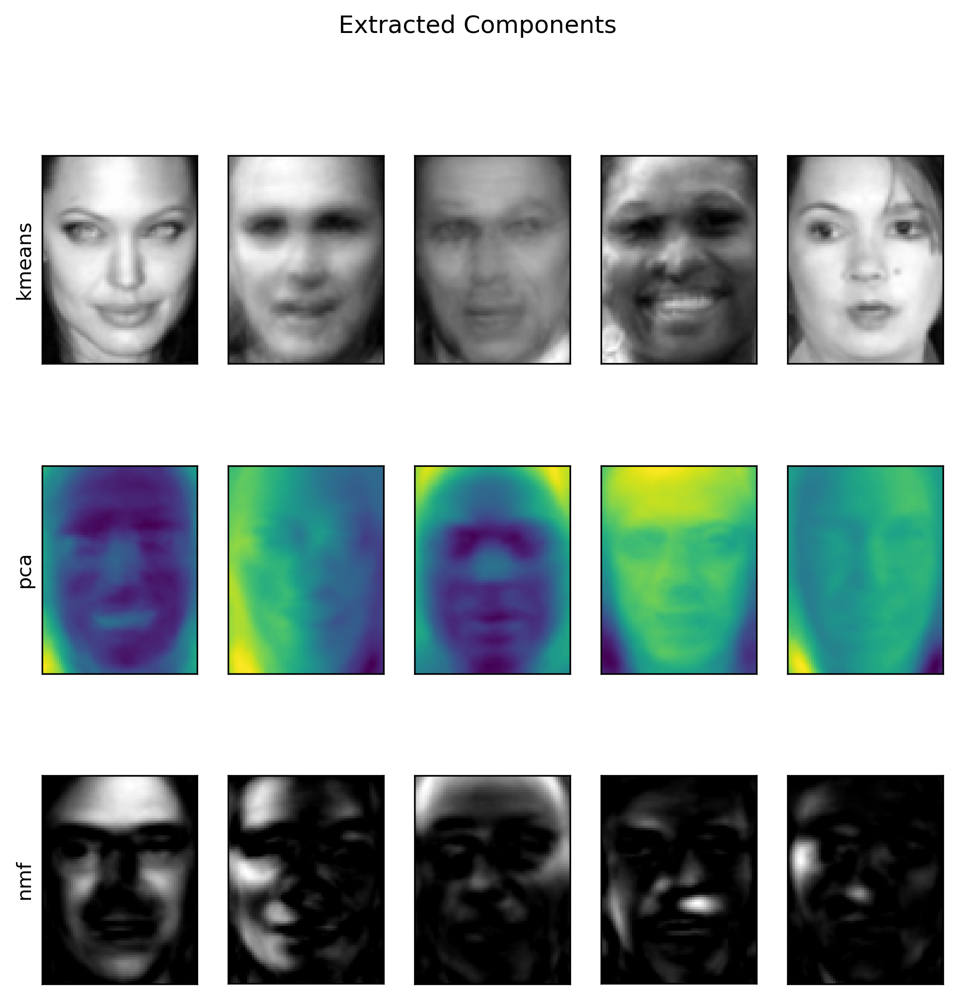

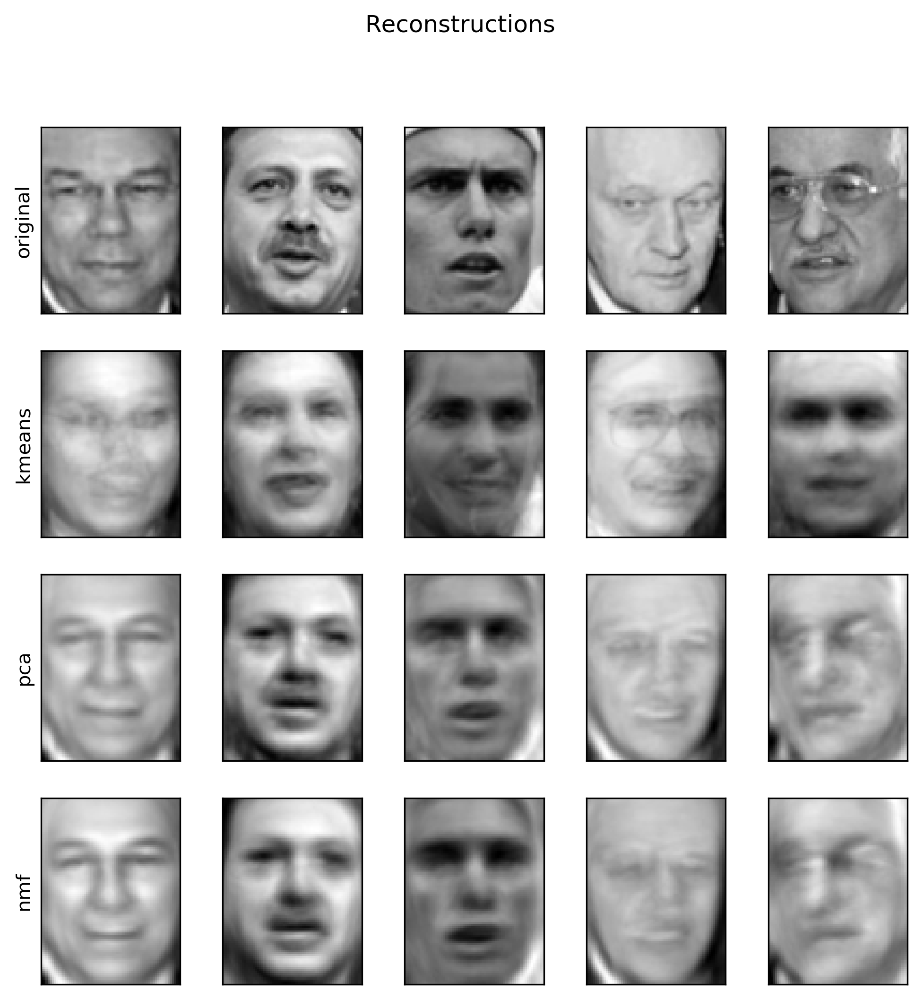

In [70]:
print("kmeans.cluster_centers_.shape: {}".format(kmeans.cluster_centers_.shape))
print("pca.components_.shape: {}".format(pca.components_.shape))
print("nmf.components_.shape: {}".format(nmf.components_.shape))

fig, axes = plt.subplots(3, 5, figsize=(8, 8), subplot_kw={'xticks': (), 'yticks': ()})
fig.suptitle("Extracted Components")
for ax, comp_kmeans, comp_pca, comp_nmf in zip(
        axes.T, 
        kmeans.cluster_centers_, 
        pca.components_, 
        nmf.components_):
    ax[0].imshow(comp_kmeans.reshape(image_shape))
    ax[1].imshow(comp_pca.reshape(image_shape), cmap='viridis')
    ax[2].imshow(comp_nmf.reshape(image_shape))

axes[0, 0].set_ylabel("kmeans")
axes[1, 0].set_ylabel("pca")
axes[2, 0].set_ylabel("nmf")

fig, axes = plt.subplots(4, 5, subplot_kw={'xticks': (), 'yticks': ()}, figsize=(8, 8))
fig.suptitle("Reconstructions")
for ax, orig, rec_kmeans, rec_pca, rec_nmf in zip(
        axes.T,
        X_test,
        X_reconstructed_kmeans,
        X_reconstructed_pca,
        X_reconstructed_nmf):

    ax[0].imshow(orig.reshape(image_shape))
    ax[1].imshow(rec_kmeans.reshape(image_shape))
    ax[2].imshow(rec_pca.reshape(image_shape))
    ax[3].imshow(rec_nmf.reshape(image_shape))

axes[0, 0].set_ylabel("original")
axes[1, 0].set_ylabel("kmeans")
axes[2, 0].set_ylabel("pca")
axes[3, 0].set_ylabel("nmf")

- k-Means로 입력 데이터의 차원보다 더 많은 클러스터를 사용해 데이터를 인코딩할 수 있음

Cluster memberships:
[9 2 5 4 2 7 9 6 9 6 1 0 2 6 1 9 3 0 3 1 7 6 8 6 8 5 2 7 5 8 9 8 6 5 3 7 0
 9 4 5 0 1 3 5 2 8 9 1 5 6 1 0 7 4 6 3 3 6 3 8 0 4 2 9 6 4 8 2 8 4 0 4 0 5
 6 4 5 9 3 0 7 8 0 7 5 8 9 8 0 7 3 9 7 1 7 2 2 0 4 5 6 7 8 9 4 5 4 1 2 3 1
 8 8 4 9 2 3 7 0 9 9 1 5 8 5 1 9 5 6 7 9 1 4 0 6 2 6 4 7 9 5 5 3 8 1 9 5 6
 3 5 0 2 9 3 0 8 6 0 3 3 5 6 3 2 0 2 3 0 2 6 3 4 4 1 5 6 7 1 1 3 2 4 7 2 7
 3 8 6 4 1 4 3 9 9 5 1 7 5 8 2]


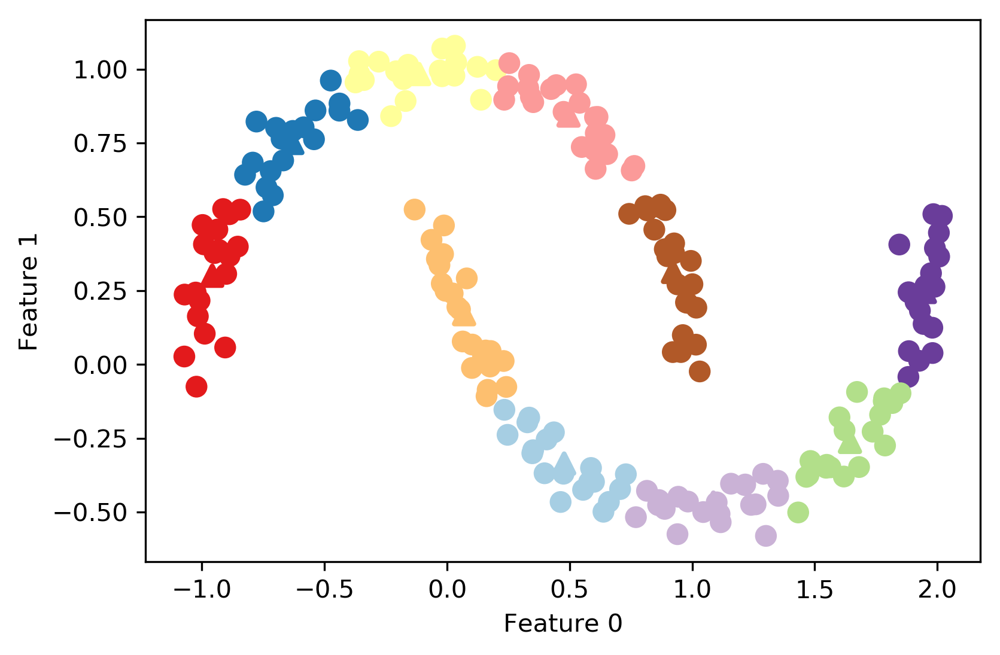

In [71]:
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

kmeans = KMeans(n_clusters=10, random_state=0)
kmeans.fit(X)
y_pred = kmeans.predict(X)

plt.scatter(X[:, 0], X[:, 1], c=y_pred, s=60, cmap='Paired')
plt.scatter(
    kmeans.cluster_centers_[:, 0], 
    kmeans.cluster_centers_[:, 1], 
    s=60,
    marker='^', 
    c=range(kmeans.n_clusters), 
    linewidth=2, 
    cmap='Paired'
)

plt.xlabel("Feature 0")
plt.ylabel("Feature 1")
print("Cluster memberships:\n{}".format(y_pred))

- kmeans.transform(X)
  - 각 데이터마다 대응되는 중심까지의 거리를 특성으로 사용하는 데이터 생성

In [72]:
distance_features = kmeans.transform(X)
print("Distance feature shape: {}".format(distance_features.shape))
print("Distance features:\n{}".format(distance_features))

Distance feature shape: (200, 10)
Distance features:
[[ 0.922  1.466  1.14  ...,  1.166  1.039  0.233]
 [ 1.142  2.517  0.12  ...,  0.707  2.204  0.983]
 [ 0.788  0.774  1.749 ...,  1.971  0.716  0.944]
 ..., 
 [ 0.446  1.106  1.49  ...,  1.791  1.032  0.812]
 [ 1.39   0.798  1.981 ...,  1.978  0.239  1.058]
 [ 1.149  2.454  0.045 ...,  0.572  2.113  0.882]]


- 대규모 데이터에 대한 k-Means 적용방법
  - MiniBatchKMeans 사용
    - batch_size의 기본 값: 100
    - 전체 데이터에서 100개를 임의로 선택하여 클러스터 중심 계산

- k-Means의 단점
  - 난수 초기화에 따라 k-Means 클러스터링 결과 달라짐
    - scikit-learn의 대처 방법
      - 10개의 서로 다른 난수 초기값을 적용하여 k-Means를 수행하고 각 결과에서 산출되는 클러스터 분산의 합이 작은 것을 최종 결과로 택함
  - 클러스의 모양이 제한적
    - 클러스터 경계가 각 클러스터 중심에서 동일한 거리에 존재
  - 사용자가 클러스터의 개수를 직접 지정

#### 3.5.2 Agglomerative (병합) Clustering
- 알고리즘 초기에 각 데이터 포인트 하나당 하나의 클러스터로 지정
- 이후 종료 조건이 만족할 때까지 가장 유사한 두 개의 클러스터를 병합
- scikit-learn의 종료조건
  - 지정된 개수의 클러스터 개수로 줄어들때 까지 수행
  - AgglomerativeClustering(n_clusters=3): 3개의 클러스터가 남게 됨
- linkage 옵션: 유사한 클러스터를 측정하는 방법 지정
  - ward
    - 병합될 클러스터내의 분산을 가장 적게 증가시키는 두 클러스터를 병합
  - average
    - 병합될 클러스터 포인트 사이의 평균 거리가 가장 짧은 두 클러스터를 병합 (it uses the average of the distances of each observation of the two sets)
  - complete
    - 병합될 클러스터 포인트 사이의 최대 거리가 가장 짧은 두 클러스터를 병합 (it uses the maximum distances between all observations of the two sets)
- 참고: http://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html

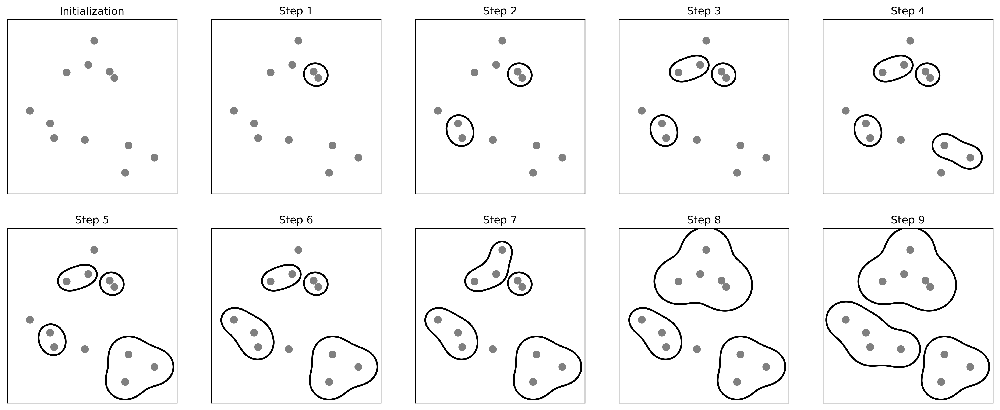

In [73]:
mglearn.plots.plot_agglomerative_algorithm()

Text(0,0.5,'Feature 1')

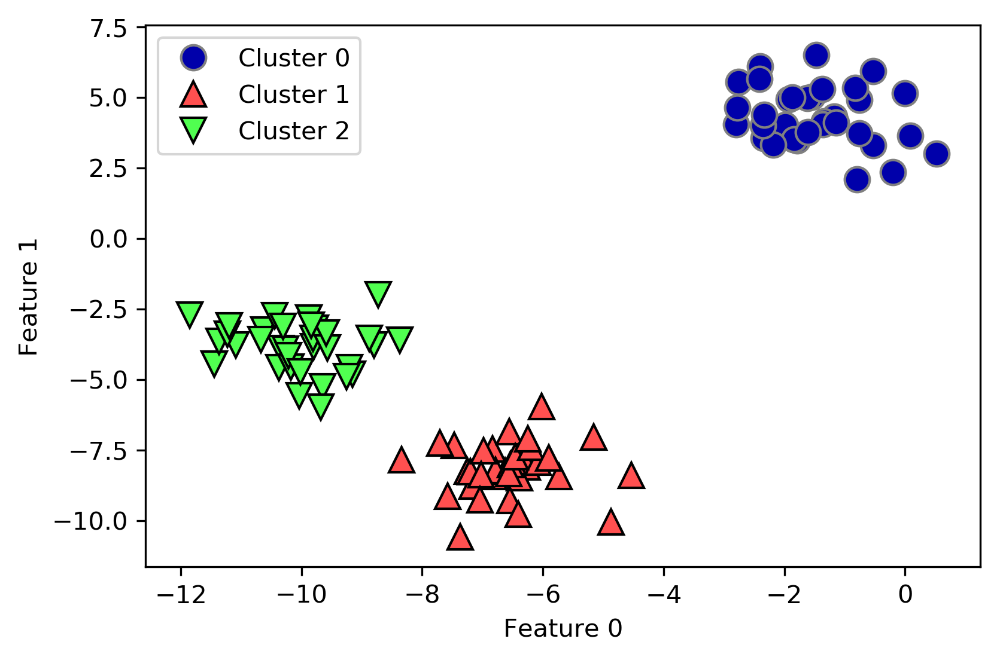

In [74]:
from sklearn.cluster import AgglomerativeClustering
X, y = make_blobs(random_state=1)

agg = AgglomerativeClustering(n_clusters=3)
assignment = agg.fit_predict(X)

mglearn.discrete_scatter(X[:, 0], X[:, 1], assignment)
plt.legend(["Cluster 0", "Cluster 1", "Cluster 2"], loc="best")
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

##### Hierarchical Clustering and Dendrograms
- 병합 클러스터링은 자연스럽게 계층적 클러스터링 기법이 된다. 
- 병합 클러스터링 알고리즘 수행 중간 단계에서는 각기 다른 개수의 클러스터를 생성함.

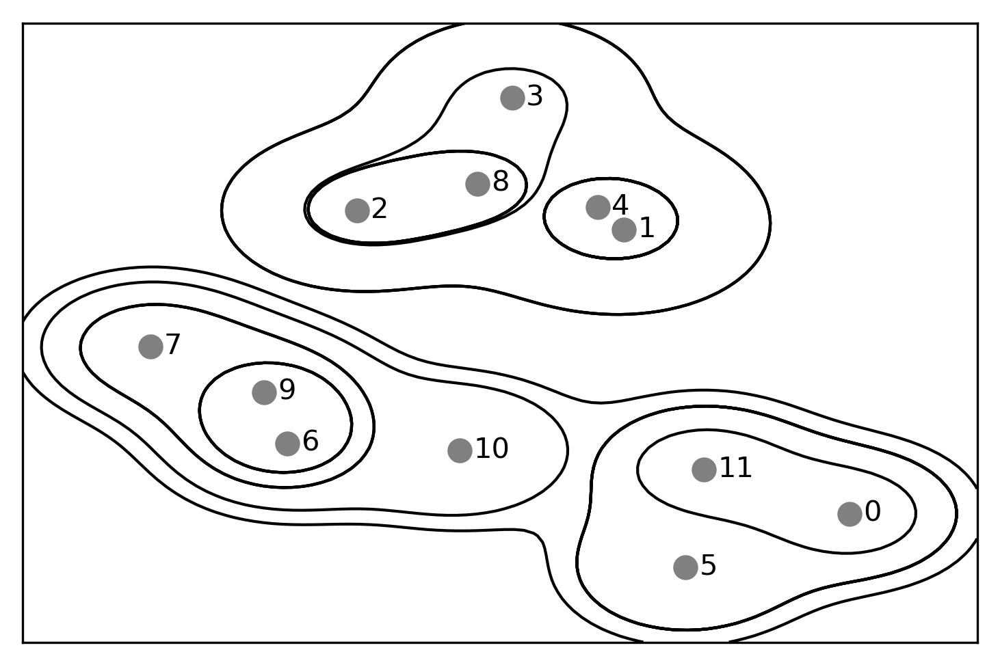

In [75]:
mglearn.plots.plot_agglomerative()

- Dendrogram
  - 계층 클러스터링 시각화 그래프
  - scikit-learn에서는 이 그래프를 그리는 기능 제공하지 않음
  - 대신 SciPy 패키지 사용 가능
    - linkage_array = ward(X)
      - 계층 군집의 유사도 및 클러스터링 단계를 포함하는 연결 배열 반환

In [76]:
# Import the dendrogram function and the ward clustering function from SciPy
from scipy.cluster.hierarchy import dendrogram, ward

X, y = make_blobs(random_state=0, n_samples=12)

# Apply the ward clustering to the data array X
# The SciPy ward function returns an array that specifies the distances
# bridged when performing agglomerative clustering
linkage_array = ward(X)
print(linkage_array)

[[  1.      4.      0.332   2.   ]
 [  6.      9.      0.646   2.   ]
 [  2.      8.      0.927   2.   ]
 [  0.     11.      1.18    2.   ]
 [  5.     15.      1.303   3.   ]
 [  7.     13.      1.444   3.   ]
 [  3.     14.      1.6     3.   ]
 [ 12.     18.      2.078   5.   ]
 [ 10.     17.      2.16    4.   ]
 [ 16.     20.      6.55    7.   ]
 [ 19.     21.      7.924  12.   ]]


Text(0,0.5,'Cluster distance')

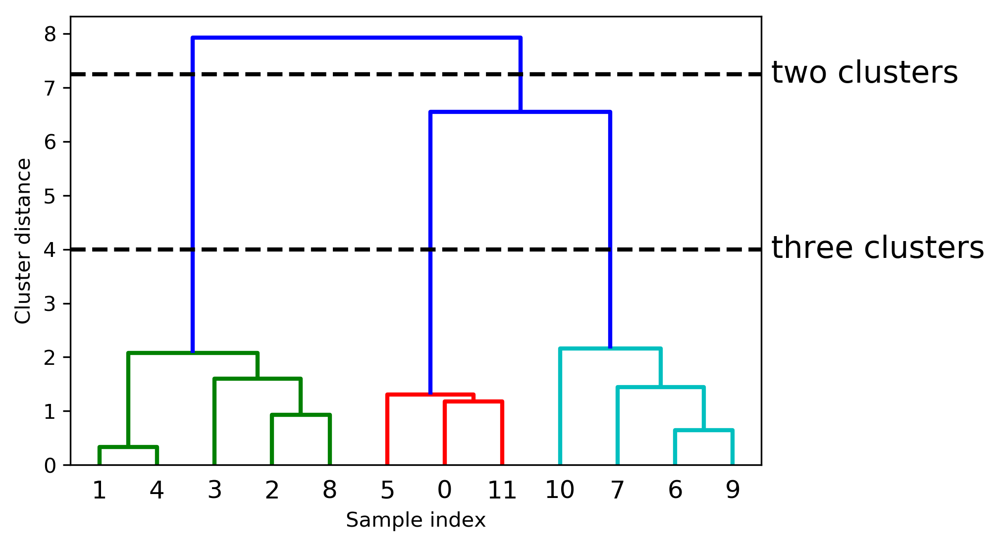

In [77]:
# Now we plot the dendrogram for the linkage_array containing the distances
# between clusters
dendrogram(linkage_array)

# mark the cuts in the tree that signify two or three clusters
ax = plt.gca()
bounds = ax.get_xbound()
ax.plot(bounds, [7.25, 7.25], '--', c='k')
ax.plot(bounds, [4, 4], '--', c='k')

ax.text(bounds[1], 7.25, ' two clusters', va='center', fontdict={'size': 15})
ax.text(bounds[1], 4, ' three clusters', va='center', fontdict={'size': 15})
plt.xlabel("Sample index")
plt.ylabel("Cluster distance")

- 위 Dendrogram에서 가지의 길이는 합쳐진 클러스터가 얼마나 멀리 떨어져 있는지를 나타냄.

#### 3.5.3 DBSCAN (Density-Based Spatial Clustering of Applications with Noise)
- http://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html
- 장점
  - 클러스터 개수 지정 필요 없음
  - 데이터 포인트들의 복잡한 형상도 분석하여 클러스터링 가능
  - 어떠한 클러스터에도 속하지 않는 포인트도 구분 가능
  - 비교적 큰 데이터셋에도 적용가능<br/><br/>
- 주요 개념
  - Dense Region (밀집 지역)
    - 특성 공간에서 유사한 공간에 데이터가 많이 밀집되어 있는 지역
    - DBSCAN의 기본 아이디어: 클러스터 구성 기반으로서 데이터의 밀집 지역 활용
  - Core Sample (or Core Points, 핵심 샘플, 핵심 포인트)
    - 주요 매개변수: eps (기본값:0.5), min_samples (기본값:5)
    - 임의의 데이터 포인트 $p$에서 eps 거리 안에 min_samples 개수 만큼의 데이터 포인트가 들어 있으면 해당 $p$를 핵심 포인트포 분류하고 이들 데이터 포인트들을 동일한 클러스터로 병합함<br/><br/>

- 주요 데이터 포인트 정리 (from wikipedia)
  - A point $p$ is a core point if at least $min\_samples$ points are within distance $eps$ ($eps$ is the maximum radius of the neighborhood from $p$) of it (including $p$). 
  - Those points are said to be directly reachable from $p$.
  - A point $q$ is **directly reachable** from $p$ if point q is within distance $eps$ from point $p$ and $p$ must be a core point.
  - A point $q$ is **reachable** from $p$ if there is a path $p_1$, ..., $p_n$ with $p_1 = p$ and $p_n = q$, where each $p_{i+1}$ is directly reachable from $p_i$ (all the points on the path must be core points, with the possible exception of $q$).
  - All points not reachable from any other point are **outliers**.<br/><br/>
      
- 임의의 포인트는 다음과 같이 3개의 종류로 나뉨
  - Core Points
  - Boundary Points
    - 경계 포인트는 두 개 이상의 클러스터 핵심 포인트의 이웃일 수 있음.
    - 이러한 경우, 방문 순서에 의해 클러스터 소속이 결정됨.
    - 이러한 경계 포인트의 개수는 일반적으로 그렇게 많지 않음.
  - Noise (or Outlier) Points
  <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/a/af/DBSCAN-Illustration.svg/800px-DBSCAN-Illustration.svg.png" width="50%"/>
  - Eample (see the above figure)
    - In the above diagram, $min\_samples$ = 4. 
    - Point $A$ and the other red points are core points, because the area surrounding these points in an $eps$ radius contain at least 4 points (including the point itself). 
    - Because they are all reachable from one another, they form a single cluster. 
    - Points $B$ and $C$ are not core points, but are reachable from $A$ (via other core points) and thus belong to the cluster as well (Point $B$ and $C$ are boundary points).
    - Point $N$ is a noise point that is neither a core point nor directly-reachable.

In [78]:
from sklearn.cluster import DBSCAN
X, y = make_blobs(random_state=0, n_samples=12)

dbscan = DBSCAN()
clusters = dbscan.fit_predict(X)
print("Cluster memberships:\n{}".format(clusters))

Cluster memberships:
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]


min_samples: 2 eps: 1.000000  cluster: [-1  0  0 -1  0 -1  1  1  0  1 -1 -1]
min_samples: 2 eps: 1.500000  cluster: [0 1 1 1 1 0 2 2 1 2 2 0]
min_samples: 2 eps: 2.000000  cluster: [0 1 1 1 1 0 0 0 1 0 0 0]
min_samples: 2 eps: 3.000000  cluster: [0 0 0 0 0 0 0 0 0 0 0 0]
min_samples: 3 eps: 1.000000  cluster: [-1  0  0 -1  0 -1  1  1  0  1 -1 -1]
min_samples: 3 eps: 1.500000  cluster: [0 1 1 1 1 0 2 2 1 2 2 0]
min_samples: 3 eps: 2.000000  cluster: [0 1 1 1 1 0 0 0 1 0 0 0]
min_samples: 3 eps: 3.000000  cluster: [0 0 0 0 0 0 0 0 0 0 0 0]
min_samples: 5 eps: 1.000000  cluster: [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]
min_samples: 5 eps: 1.500000  cluster: [-1  0  0  0  0 -1 -1 -1  0 -1 -1 -1]
min_samples: 5 eps: 2.000000  cluster: [-1  0  0  0  0 -1 -1 -1  0 -1 -1 -1]
min_samples: 5 eps: 3.000000  cluster: [0 0 0 0 0 0 0 0 0 0 0 0]


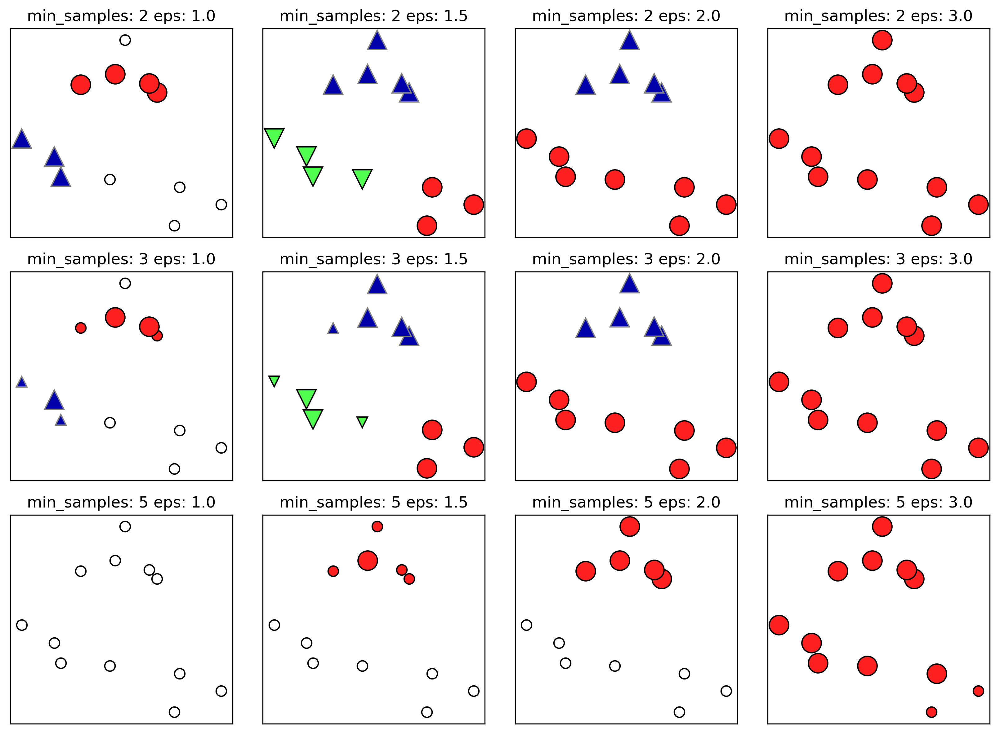

In [79]:
mglearn.plots.plot_dbscan()

Text(0,0.5,'Feature 1')

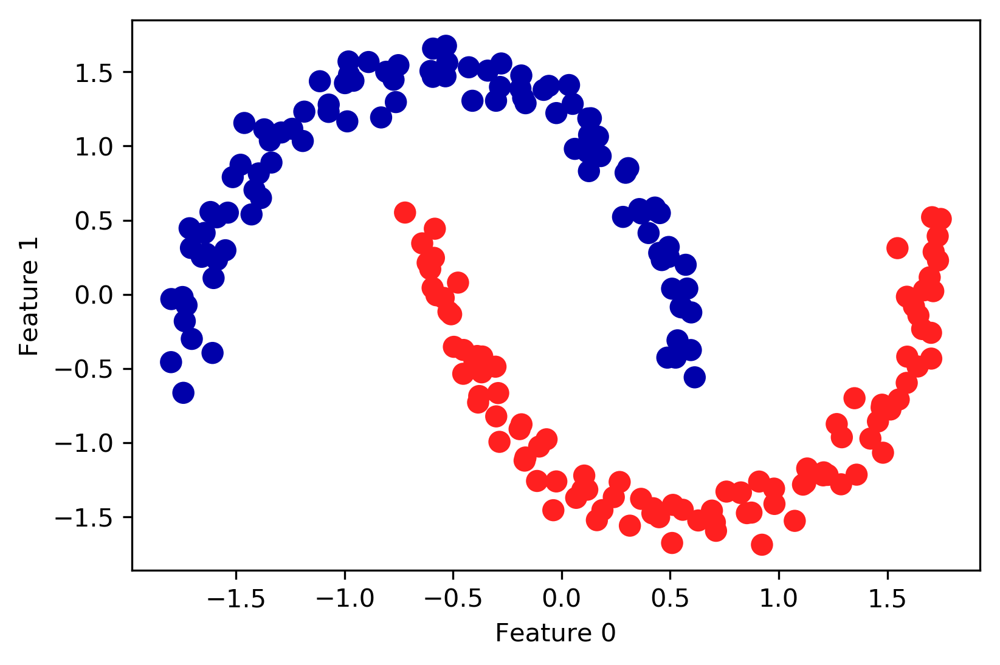

In [80]:
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# Rescale the data to zero mean and unit variance
scaler = StandardScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)

dbscan = DBSCAN()
clusters = dbscan.fit_predict(X_scaled)
# plot the cluster assignments
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm2, s=60)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

##### 3.5.4 Comparing and evaluating clustering algorithms
##### Evaluating clustering with ground truth
- 훈련 데이터에 대한 Target을 알고 있을 때 Clustering Algorithm 평가방법
  - ARI (Adjusted Rand Index)
    - adjusted_rand_score(y, predicted_clusters)
    - 무작위 클러스터링: 0
    - 1에 가까운 값일수록 타깃과 더 유사한 클러스터링 결과
  - NMI (Normalized Mutual Information)
    - normalized_mutual_infro_score(y, predicted_clusters)  
    - 무작위 클러스터링: 0
    - 1에 가까운 값일수록 타깃과 더 유사한 클러스터링 결과    

In [81]:
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# Rescale the data to zero mean and unit variance
scaler = StandardScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)

- ARI (Adjusted Rand Index)

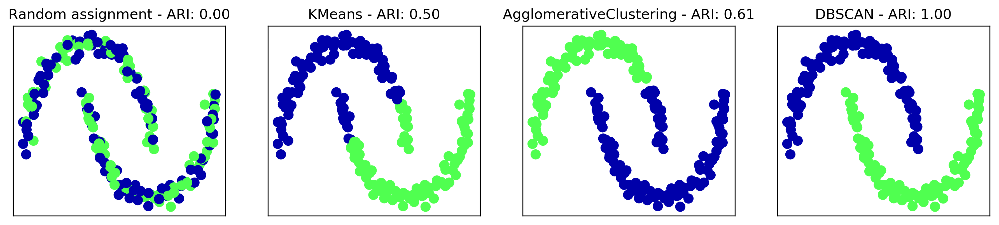

In [82]:
from sklearn.metrics.cluster import adjusted_rand_score

fig, axes = plt.subplots(1, 4, figsize=(15, 3), subplot_kw={'xticks': (), 'yticks': ()})

# make a list of algorithms to use
algorithms = [KMeans(n_clusters=2), AgglomerativeClustering(n_clusters=2), DBSCAN()]

# create a random cluster assignment for reference
random_state = np.random.RandomState(seed=0)
random_clusters = random_state.randint(low=0, high=2, size=len(X))

# plot random assignment
axes[0].scatter(X_scaled[:, 0], X_scaled[:, 1], c=random_clusters, cmap=mglearn.cm3, s=60)
axes[0].set_title("Random assignment - ARI: {:.2f}".format(adjusted_rand_score(y, random_clusters)))

for ax, algorithm in zip(axes[1:], algorithms):
    # plot the cluster assignments and cluster centers
    clusters = algorithm.fit_predict(X_scaled)
    ax.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm3, s=60)
    ax.set_title("{} - ARI: {:.2f}".format(algorithm.__class__.__name__, adjusted_rand_score(y, clusters)))

- NMI (Normalized Mutual Information)

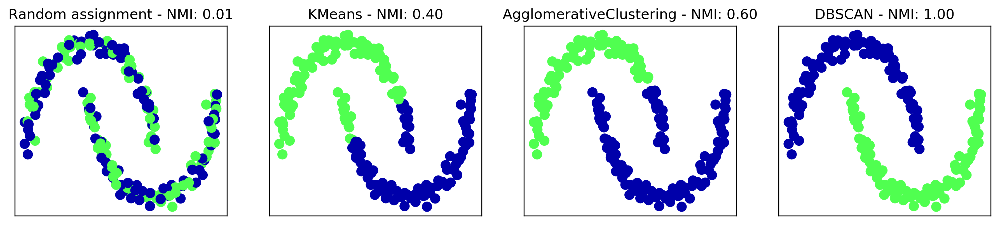

In [83]:
from sklearn.metrics.cluster import normalized_mutual_info_score

fig, axes = plt.subplots(1, 4, figsize=(15, 3), subplot_kw={'xticks': (), 'yticks': ()})

# make a list of algorithms to use
algorithms = [KMeans(n_clusters=2), AgglomerativeClustering(n_clusters=2), DBSCAN()]

# create a random cluster assignment for reference
random_state = np.random.RandomState(seed=0)
random_clusters = random_state.randint(low=0, high=2, size=len(X))

# plot random assignment
axes[0].scatter(X_scaled[:, 0], X_scaled[:, 1], c=random_clusters, cmap=mglearn.cm3, s=60)
axes[0].set_title("Random assignment - NMI: {:.2f}".format(normalized_mutual_info_score(y, random_clusters)))

for ax, algorithm in zip(axes[1:], algorithms):
    # plot the cluster assignments and cluster centers
    clusters = algorithm.fit_predict(X_scaled)
    ax.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm3, s=60)
    ax.set_title("{} - NMI: {:.2f}".format(algorithm.__class__.__name__, normalized_mutual_info_score(y, clusters)))

- accuracy_score 는 사용하면 안됨

In [84]:
from sklearn.metrics import accuracy_score

# these two labelings of points correspond to the same clustering
clusters1 = [0, 0, 1, 1, 0]
clusters2 = [1, 1, 0, 0, 1]
# accuracy is zero, as none of the labels are the same
print("Accuracy: {:.2f}".format(accuracy_score(clusters1, clusters2)))

# adjusted rand score is 1, as the clustering is exactly the same:
print("ARI: {:.2f}".format(adjusted_rand_score(clusters1, clusters2)))

# normalized mutual information score is 1, as the clustering is exactly the same:
print("NMI: {:.2f}".format(normalized_mutual_info_score(clusters1, clusters2)))

Accuracy: 0.00
ARI: 1.00
NMI: 1.00


##### Evaluating clustering without ground truth
- 수집한 데이터 자체에 Target 값이 없을 때 클러스터링 알고리즘 성능 평가하기
  - Sihouette Coefficient (실루엣 계수)
    - 그다지 추천하지 않음
    - 클러스터의 밀집정도를 계산함 - 밀집정도가 높을 수록 1에 가까운 값을 반환함.
  - Robustness-based Evaluation (견고성 기반 평가)
    - 데이터에 잡음 포인트를 추가하거나 여러가지 매개변수 설정으로 알고리즘을 실행하여도 클러스터 구성이 변하지 않을 때 해당 클러스터 구성 결과에 높은 신뢰도가 있다고 볼 수 있음
    - scikit-learn에서는 지원하지 않음
  - 사람이 직접 확인하는 방법

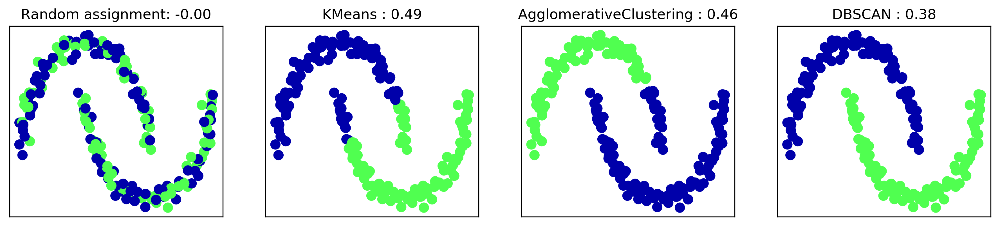

In [85]:
from sklearn.metrics.cluster import silhouette_score

X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# rescale the data to zero mean and unit variance
scaler = StandardScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)

fig, axes = plt.subplots(1, 4, figsize=(15, 3), subplot_kw={'xticks': (), 'yticks': ()})

# create a random cluster assignment for reference
random_state = np.random.RandomState(seed=0)
random_clusters = random_state.randint(low=0, high=2, size=len(X))

# plot random assignment
axes[0].scatter(X_scaled[:, 0], X_scaled[:, 1], c=random_clusters, cmap=mglearn.cm3, s=60)
axes[0].set_title("Random assignment: {:.2f}".format(silhouette_score(X_scaled, random_clusters)))

algorithms = [KMeans(n_clusters=2), AgglomerativeClustering(n_clusters=2), DBSCAN()]

for ax, algorithm in zip(axes[1:], algorithms):
    clusters = algorithm.fit_predict(X_scaled)
    # plot the cluster assignments and cluster centers
    ax.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm3, s=60)
    ax.set_title("{} : {:.2f}".format(algorithm.__class__.__name__, silhouette_score(X_scaled, clusters)))

##### Comparing algorithms on the faces dataset
- LFW 데이터셋에 대한 k-means, DBSCAN, Agglomerative Clustering 적용 결과 비교
- LFW 데이터셋에 대하여 PCA 적용하여 주성분 100개의 얼굴데이터 활용

In [86]:
# extract eigenfaces from lfw data and transform data
from sklearn.decomposition import PCA
pca = PCA(n_components=100, whiten=True, random_state=0)
pca.fit_transform(X_people)
X_pca = pca.transform(X_people)

##### Analyzing the faces dataset with DBSCAN

- eps=0.5, min_samples=5

In [87]:
# apply DBSCAN with default parameters
dbscan = DBSCAN()
labels = dbscan.fit_predict(X_pca)
print("Unique labels: {}".format(np.unique(labels)))

Unique labels: [-1]


- eps=0.5, min_samples=3

In [88]:
dbscan = DBSCAN(min_samples=3)
labels = dbscan.fit_predict(X_pca)
print("Unique labels: {}".format(np.unique(labels)))

Unique labels: [-1]


- eps=15, min_samples=3

In [89]:
dbscan = DBSCAN(min_samples=3, eps=15)
labels = dbscan.fit_predict(X_pca)
print("Unique labels: {}".format(np.unique(labels)))

Unique labels: [-1  0]


- 잡음 포인트와 클러스터로 분류된 포인트의 개수를 카운트
- np.bincount 활용
  - np.bincount는 음수를 허용하지 않기 때문에 1을 더하여 활용 
  - 잡음 포인트: 31개
  - 클러스터로 분류된 포인트: 1945개

In [90]:
# count number of points in all clusters and noise.
# bincount doesn't allow negative numbers, so we need to add 1.
# the first number in the result corresponds to noise points
print("Number of points per cluster: {}".format(np.bincount(labels + 1)))

Number of points per cluster: [  31 1945]


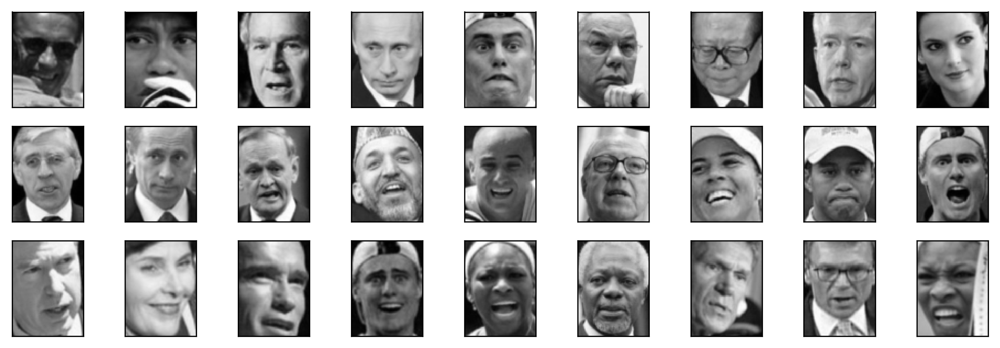

In [91]:
noise = X_people[labels==-1]

fig, axes = plt.subplots(3, 9, subplot_kw={'xticks': (), 'yticks': ()}, figsize=(12, 4))
for image, ax in zip(noise, axes.ravel()):
    ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)

- 잡음으로 분류된 이유 추정
  - 손이 얼굴 앞을 가리고 있는 경우
  - 얼굴 각도가 이상한 경우
  - 얼굴을 너무 가까이서 혹은 너무 멀리서 자른 경우
- Outlier Detection (이상치 검출)

- eps 값을 줄여서 더 많은 클러스터 구성하기

In [92]:
for eps in [1, 3, 5, 7, 9, 11, 13]:
    print("\neps={}".format(eps))
    dbscan = DBSCAN(eps=eps, min_samples=3)
    labels = dbscan.fit_predict(X_pca)
    print("Number of clusters: {}".format(len(np.unique(labels))))
    print("Cluster sizes: {}".format(np.bincount(labels + 1)))


eps=1
Number of clusters: 1
Cluster sizes: [1976]

eps=3
Number of clusters: 1
Cluster sizes: [1976]

eps=5
Number of clusters: 1
Cluster sizes: [1976]

eps=7
Number of clusters: 9
Cluster sizes: [1920   19   14    3    3    3    7    3    4]

eps=9
Number of clusters: 5
Cluster sizes: [1212  754    3    4    3]

eps=11
Number of clusters: 2
Cluster sizes: [ 393 1583]

eps=13
Number of clusters: 2
Cluster sizes: [ 118 1858]


- DBSCAN의 단점
  - 클러스터의 개수 컨트롤을 직접적으로 할 수 없음
  - 사이즈가 큰 하나의 클러스터가 항상 생성되고 있음

Cluster: 0, n_images: 19
Cluster: 1, n_images: 14
Cluster: 2, n_images: 3
Cluster: 3, n_images: 3
Cluster: 4, n_images: 3
Cluster: 5, n_images: 7
Cluster: 6, n_images: 3
Cluster: 7, n_images: 4


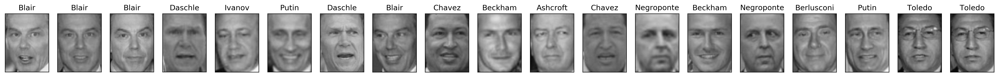

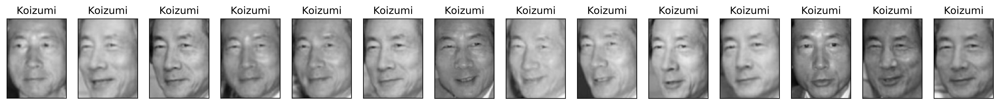

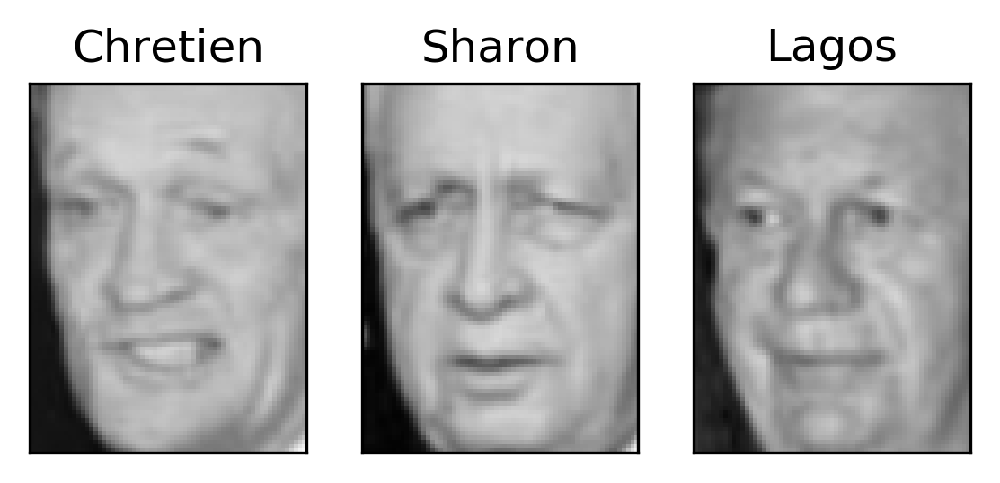

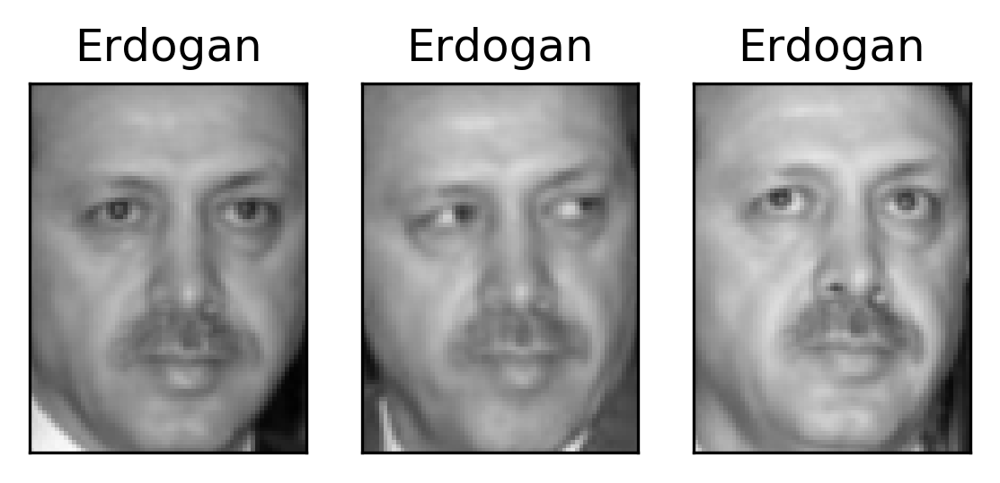

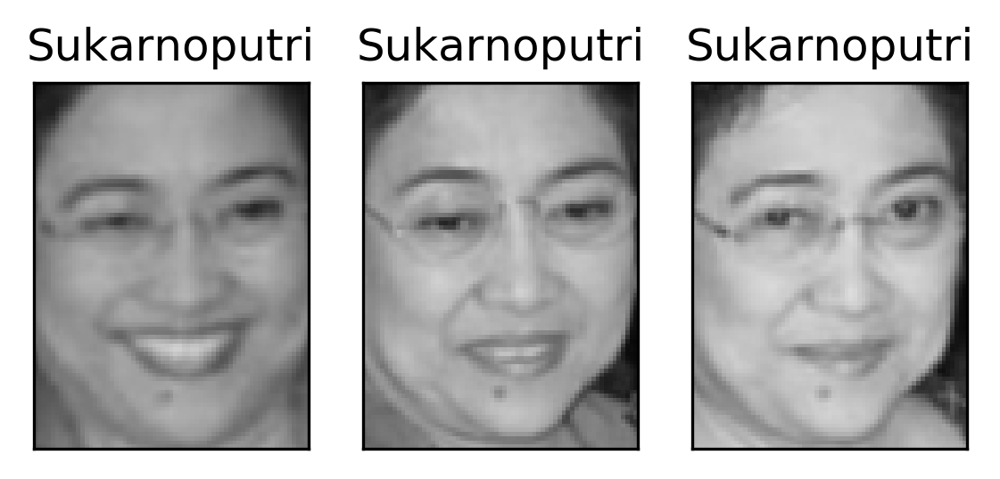

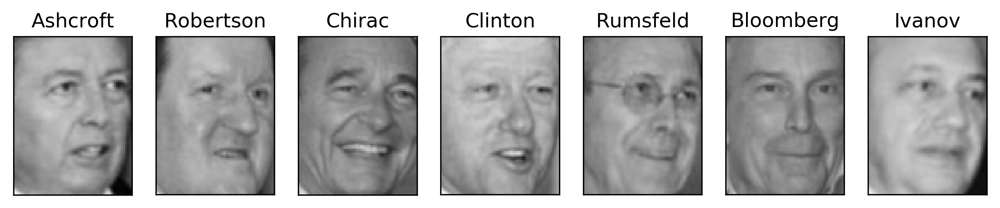

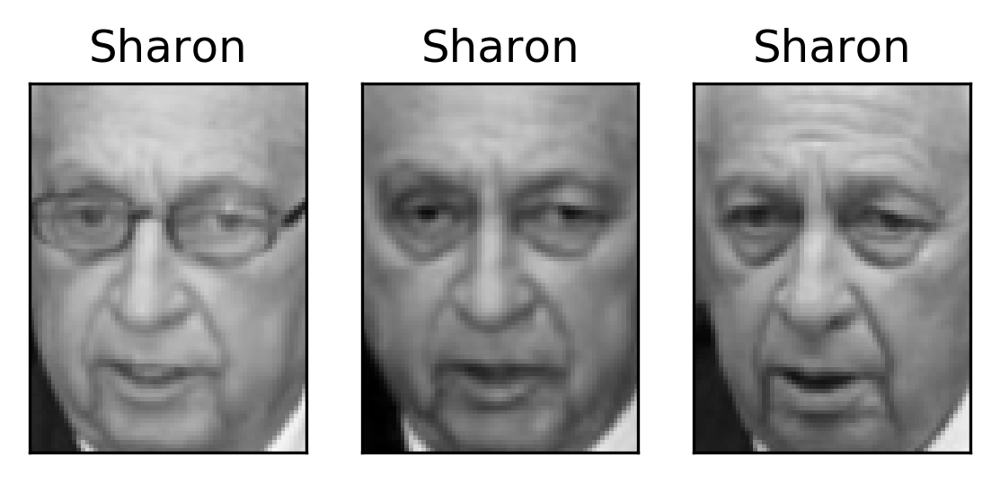

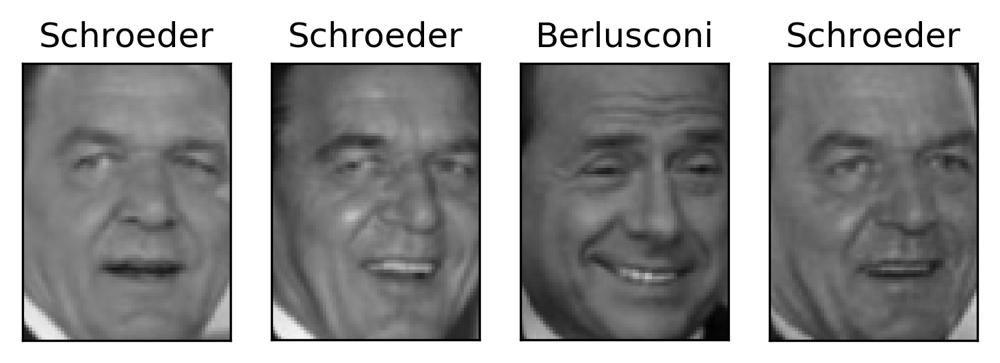

In [93]:
dbscan = DBSCAN(min_samples=3, eps=7)
labels = dbscan.fit_predict(X_pca)

for cluster in range(max(labels) + 1):
    mask = labels == cluster
    n_images = np.sum(mask)
    print("Cluster: {0}, n_images: {1}".format(cluster, n_images))
    
    fig, axes = plt.subplots(1, n_images, figsize=(n_images * 1.5, 4), subplot_kw={'xticks': (), 'yticks': ()})
    for image, label, ax in zip(X_people[mask], y_people[mask], axes):
        ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
        ax.set_title(people.target_names[label].split()[-1])

##### Analyzing the faces dataset with k-Means

In [94]:
# extract clusters with k-Means
km = KMeans(n_clusters=10, random_state=0)
labels_km = km.fit_predict(X_pca)
print("Cluster sizes k-means: {}".format(np.bincount(labels_km)))

Cluster sizes k-means: [191 243 130 218 298 114 296  85 147 254]


- k-means 클러스터 center 10개를 원본 이미지로 inverse_transform 하여 시각화하기

km.cluster_centers_.shape: (10, 100)


NameError: name 'center' is not defined

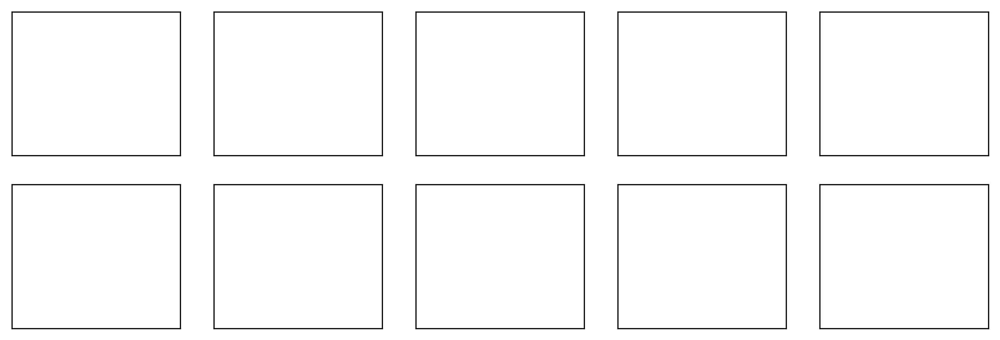

In [95]:
fig, axes = plt.subplots(2, 5, subplot_kw={'xticks': (), 'yticks': ()}, figsize=(12, 4))

print("km.cluster_centers_.shape:", km.cluster_centers_.shape)
print("pca.inverse_transform(center).shape: ", pca.inverse_transform(center).shape)
for center, ax in zip(km.cluster_centers_, axes.ravel()):
    ax.imshow(pca.inverse_transform(center).reshape(image_shape), vmin=0, vmax=1)

- 위 center 이미지는 각 클러스터에 속한 얼굴 이미지의 평균이라고 간주해야 함
- 특히 PCA를 사용하여 감소된 특성과 함께 k-means를 적용했기 때문에 각 이미지가 더욱 부드러워졌음
- 각 center 이미지는 각기 다른 얼굴 각도와 다른 표정을 지니고 있다고 볼 수 있음

- 각 클러스터 10개에 대하여 가장 대표적인 이미지 5개와 가장 동떨어진 이미지 5개 시각화하기

In [ ]:
mglearn.plots.plot_kmeans_faces(km, pca, X_pca, X_people, y_people, people.target_names)

##### Analyzing the faces dataset with agglomerative clustering

In [ ]:
# extract clusters with ward agglomerative clustering
agglomerative = AgglomerativeClustering(n_clusters=10)
labels_agg = agglomerative.fit_predict(X_pca)
print("cluster sizes agglomerative clustering: {}".format(np.bincount(labels_agg)))

- k-means 클러스터링 결과와 AgglomerativeClustering 클러스터링 결과를 ARI 도구를 활용하여 비교 평가하기 
  - 결과값: 0.13 - 공통 부분이 거의 없다고 볼 수 있음

In [ ]:
print("ARI: {:.2f}".format(adjusted_rand_score(labels_agg, labels_km)))

- Dendrogram 그리기 
  - 트리 깊이 제한
    - p=7, truncate_mode='level'
      - 최대 level을 7로 제한

In [ ]:
linkage_array = ward(X_pca)
# now we plot the dendrogram for the linkage_array
# containing the distances between clusters
plt.figure(figsize=(20, 5))
dendrogram(linkage_array, p=7, truncate_mode='level', no_labels=True)
plt.xlabel("Sample index")
plt.ylabel("Cluster distance")

In [ ]:
n_clusters = 10

for cluster in range(n_clusters):
    mask = labels_agg == cluster
    fig, axes = plt.subplots(1, 10, subplot_kw={'xticks': (), 'yticks': ()}, figsize=(15, 8))
    axes[0].set_ylabel(np.sum(mask))
    for image, label, asdf, ax in zip(X_people[mask], y_people[mask], labels_agg[mask], axes):
        ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
        ax.set_title(people.target_names[label].split()[-1], fontdict={'fontsize': 9})

In [ ]:
# extract clusters with ward agglomerative clustering
agglomerative = AgglomerativeClustering(n_clusters=40)
labels_agg = agglomerative.fit_predict(X_pca)
print("cluster sizes agglomerative clustering: {}".format(np.bincount(labels_agg)))

n_clusters = 40
for cluster in [10, 13, 19, 22, 36]: # hand-picked "interesting" clusters
    mask = labels_agg == cluster
    fig, axes = plt.subplots(1, 15, subplot_kw={'xticks': (), 'yticks': ()}, figsize=(15, 8))
    cluster_size = np.sum(mask)
    axes[0].set_ylabel("#{}: {}".format(cluster, cluster_size))

    for image, label, asdf, ax in zip(X_people[mask], y_people[mask], labels_agg[mask], axes):
        ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
        ax.set_title(people.target_names[label].split()[-1], fontdict={'fontsize': 9})

    for i in range(cluster_size, 15):
        axes[i].set_visible(False)

#### Summary of Clustering Methods
- k-means
  - 장점
    - 클러스터의 Center를 명확히 짚어낼 수 있음 
- agglomerative clustering
  - 장점
    - 전체 데이터의 분할 계층도인 Dendrogram 시각화 가능
- DBSCAN
  - 장점
    - 클러스터에 속하지 않은 잡음 포인트를 인식할 수 있음
    - 클러스터 개수가 자동으로 결정됨
    - 복잡한 모양의 클러스터 형태 구분 가능

### Summary and Outlook
- Estimator (추정기)
  - scikit-learn에서 학 학습 모델 및 알고리즘을 포함하고 있는 클래스

In [ ]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()

- Estimator 모델 객체 구성시 지정하는 매개변수
  - 규제
  - 복잡도 제어
  - 클러스터 개수
- Estimator.fit
  - 모델 구성
  - 첫번째 매개변수로 훈련 데이터 X 필요
  - 지도 학습일 때에는 두 번째 매개변수로 타깃 데이터 y 지정 필요
- Estimator.predict
  - 새로운 타깃 예측 데이터 y_pred 생성
- Estimator.transform
  - 입력 데이터 X의 새로운 표현 형태 생성

![api_table](images/api_table.png)